# Oversampling

In [5]:
# importation des librairies
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [6]:
# chargement des donnees
data = pd.read_csv("Clean_Medicl_cost.csv")
data.head()

,age,sex,bmi,children,smoker,region,charges
0,19.0,0,27.900,0.0,1,0.243082,16884.92400
1,18.0,1,33.770,1.0,0,0.272251,1725.55230
2,28.0,1,33.000,3.0,0,0.272251,4449.46200
3,33.0,1,22.705,0.0,0,0.242334,21984.47061
4,32.0,1,28.880,0.0,0,0.242334,3866.85520


# Fonctions d'entrainements des modeles

## Random forest

In [7]:
## FONCTION D'ENTRAINEMENT ##
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score,confusion_matrix
from sklearn.metrics import RocCurveDisplay
from sklearn.metrics import classification_report

def random_Forest_Train(X_train, y_train):

    # INITIALISATION ET ENTRAINEMENT
    Random_forest = RandomForestClassifier(max_depth= 2) # reduction de la profondeur de l'abre pour empeche l'overfit (nombre trop bas de donnees)
    Random_forest.fit(X_train,y_train)
    
    # PREDICTION SUR LE TRAIN
    ypredict_train = Random_forest.predict(X_train)

    # DETERMINATION DES METRIQUES
    acc = accuracy_score(y_train,ypredict_train) # accuracy
    conf = confusion_matrix(y_train,ypredict_train) # confusion matrix
    svc_disp = RocCurveDisplay.from_estimator(Random_forest,X_train,y_train) # courbe ROC

    print("Accuracy : ", acc)

    plt.figure(figsize=(8,5))
    sns.heatmap(conf, annot=True)
    plt.title("Matrice de confusion")
    plt.show()

    print(classification_report(y_train,ypredict_train))
    return Random_forest

## Naives bayes

In [8]:
from sklearn.naive_bayes import GaussianNB

## FONCTION D'ENTRAINEMENT ##
def naives_bayes_train(X_train, y_train):
    # ENTRAINEMENT DU MODELE
    naives_bayes =GaussianNB()
    naives_bayes.fit(X_train,y_train)
    ypredict_train=naives_bayes.predict(X_train)

    # DETERMINATION DES METRIQUES
    acc=accuracy_score(y_train,ypredict_train) # accuracy
    conf=confusion_matrix(y_train,ypredict_train) # confusion matrix
    svc_disp=RocCurveDisplay.from_estimator(naives_bayes,X_train,y_train) # courbe ROC

    print("Accuracy : ", acc)

    plt.figure(figsize=(5,5))
    sns.heatmap(conf, annot=True)
    plt.title("Matrice de confusion")
    plt.show()

    print(classification_report(y_train,ypredict_train))
    return naives_bayes

## Xgboost

In [9]:
##  ENTREINEMENT DU MODELE ##

import xgboost as xgb
from sklearn.metrics import roc_curve, auc

def xgboost_train(X_train, y_train):
    D_train=xgb.DMatrix(X_train,label=y_train)
    param={'eta':0.3,'max_depth':2,'objective':'multi:softprob','num_class':2}
    steps = 20 # nombre de passage d'aprentissage
    xgboost_model = xgb.train(param,D_train,steps)
    ypredict_train=xgboost_model.predict(D_train)
    # Si les prédictions sont des probabilités, les convertir en labels de classe
    if ypredict_train.ndim > 1:
        ypredict_train = np.argmax(ypredict_train, axis=1)

    # DETERMINATION DES METRIQUES
    acc = accuracy_score(y_train,ypredict_train) # accuracy
    conf = confusion_matrix(y_train,ypredict_train) # confusion matrix
    
    print("Accuracy : ", acc)
    
    ypredict_train_proba = xgboost_model.predict(D_train)[:,1]
    fpr, tpr, _ = roc_curve(y_train, ypredict_train_proba)
    roc_auc = auc(fpr, tpr)

    plt.plot(fpr, tpr, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Courbe ROC')
    plt.legend(loc='lower right')
    plt.show()

    plt.figure(figsize=(8,5))
    sns.heatmap(conf, annot=True)
    plt.title("Matrice de confusion")
    plt.show()

    print(classification_report(y_train,ypredict_train))
    return xgboost_model

In [10]:
# preparation des donnees
X = data.drop(columns="smoker")
y = data[["smoker"]]
# isolation train , test
from sklearn.model_selection import train_test_split
X_train, X_test,y_train,y_test= train_test_split(X,y,test_size=0.25,random_state=123)
# standardisation des donnees 
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
X_train=sc.fit_transform(X_train)
X_test=sc.transform(X_test)

# re-equilibrge des donnees

In [11]:
from imblearn.over_sampling import (
    RandomOverSampler,
    SMOTE,
    ADASYN,
    BorderlineSMOTE,
    SVMSMOTE,
)
from sklearn.svm import SVC

oversampler_dict = {
    'random': RandomOverSampler(
        sampling_strategy='auto',
        random_state=0),

    'smote': SMOTE(
        sampling_strategy='auto',
        random_state=0,
        k_neighbors=5),

    'adasyn': ADASYN(
        sampling_strategy='auto',
        random_state=0,
        n_neighbors=5),

    'border1': BorderlineSMOTE(
        sampling_strategy='auto',
        random_state=0,
        k_neighbors=5,
        m_neighbors=10,
        kind='borderline-1'),

    'border2': BorderlineSMOTE(
        sampling_strategy='auto',
        random_state=0,
        k_neighbors=5,
        m_neighbors=10,
        kind='borderline-2'),

    'svm': SVMSMOTE(
        sampling_strategy='auto',
        random_state=0,
        k_neighbors=5,
        m_neighbors=10,
        svm_estimator=SVC(kernel='linear')),
}

In [12]:
# comparaison avant/apres re-equilibrage
def compare_smoker_distribution(original_data, resampled_data, title_suffix=''):
    """
    Compare la répartition des classes fumeurs avant/après sur-échantillonnage.
    Affiche 2 lignes de sous-graphiques pour chaque variable : original (haut), resampled (bas).
    """

    cols_to_plot = ['charges', 'age', 'bmi', 'children', 'sex', 'region']
    n_plots = len(cols_to_plot) + 1  # +1 pour la variable cible "smoker"

    fig, axes = plt.subplots(2, n_plots, figsize=(4 * n_plots, 10))
    
    for ax_row, dataset, label in zip(axes, [original_data, resampled_data], ['Avant', 'Après']):
        # Plot countplot pour 'smoker'
        sns.countplot(data=dataset, x='smoker', ax=ax_row[0])
        ax_row[0].set_title(f"{label} - Fumeur")
        ax_row[0].set_xlabel('Fumeur')
        ax_row[0].set_ylabel('Nombre')

        # Plot les autres colonnes
        for i, col in enumerate(cols_to_plot):
            if dataset[col].dtype == 'object':
                sns.countplot(data=dataset, x=col, hue='smoker', ax=ax_row[i+1])
                ax_row[i+1].set_ylabel('Nombre')
            else:
                sns.kdeplot(data=dataset, x=col, hue='smoker', fill=True, ax=ax_row[i+1])
                ax_row[i+1].set_ylabel('Densité')

            ax_row[i+1].set_title(f"{label} - {col.capitalize()}")
            ax_row[i+1].set_xlabel(col.capitalize())

    plt.suptitle(f'Comparaison Avant/Après OverSampling {title_suffix}', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

In [13]:
# visualisation des classes apres re-equilibrage 
def compare_pca_oversampling(original_data, resampled_datasets_dict):
    """
    Affiche la projection PCA du jeu original et de chaque jeu suréchantillonné sur une même ligne.
    """
    from sklearn.decomposition import PCA

    methods = ['Original'] + list(resampled_datasets_dict.keys())
    datasets = [original_data] + list(resampled_datasets_dict.values())

    n_cols = len(datasets)
    fig, axes = plt.subplots(1, n_cols, figsize=(6 * n_cols, 5))  # 1 ligne

    if n_cols == 1:
        axes = [axes]  # S'assurer que axes est itérable

    for i, (method_name, data) in enumerate(zip(methods, datasets)):
        features = ['age', 'sex', 'bmi', 'children', 'region', 'charges']
        X = data[features]
        y = data['smoker']

        # Encodage et standardisation
        X_encoded = pd.get_dummies(X, drop_first=True)
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X_encoded)

        # PCA
        pca = PCA(n_components=2)
        X_pca = pca.fit_transform(X_scaled)
        pca_df = pd.DataFrame(X_pca, columns=['PC1', 'PC2'])
        pca_df['smoker'] = y.values

        # Scatterplot
        sns.scatterplot(
            data=pca_df,
            x='PC1',
            y='PC2',
            hue='smoker',
            palette='Dark2',
            s=50,
            alpha=0.6,
            edgecolor='black',
            ax=axes[i]
        )
        axes[i].set_title(f"PCA - {method_name}")
        axes[i].set_xlabel("PC1")
        axes[i].set_ylabel("PC2")
        axes[i].legend(title="Smoker")

    plt.tight_layout()
    plt.suptitle("Comparaison PCA - Données Originales vs Suréchantillonnées", fontsize=18, y=1.05)
    plt.show()


In [14]:
# fonction de reequilibrage (Random forest)
def compare_random_forest_performance(X_train_orig, y_train_orig,
                                      X_train_res, y_train_res,
                                      X_test, y_test):
    import matplotlib.pyplot as plt
    import seaborn as sns
    from sklearn.metrics import (
        accuracy_score, confusion_matrix,
        classification_report, roc_curve, auc
    )

    # Entraînement des deux modèles
    print("=== Entraînement sur données suréchantillonnées ===")


    model_resampled = random_Forest_Train(X_train_res, y_train_res)

    print("\n=== Entraînement sur données originales ===")
    model_original = random_Forest_Train(X_train_orig, y_train_orig)

    # Test des deux modèles
    ypred_res = model_resampled.predict(X_test)
    ypred_orig = model_original.predict(X_test)

    # ROC probas
    yproba_res = model_resampled.predict_proba(X_test)[:, 1]
    yproba_orig = model_original.predict_proba(X_test)[:, 1]

    # Confusion matrices
    conf_res = confusion_matrix(y_test, ypred_res)
    conf_orig = confusion_matrix(y_test, ypred_orig)

    # Metrics
    report_res = classification_report(y_test, ypred_res, output_dict=True)
    report_orig = classification_report(y_test, ypred_orig, output_dict=True)

    acc_res = accuracy_score(y_test, ypred_res)
    acc_orig = accuracy_score(y_test, ypred_orig)

    # Courbes ROC
    fpr_res, tpr_res, _ = roc_curve(y_test, yproba_res)
    fpr_orig, tpr_orig, _ = roc_curve(y_test, yproba_orig)
    auc_res = auc(fpr_res, tpr_res)
    auc_orig = auc(fpr_orig, tpr_orig)

    # ==== VISUALISATION ====
    fig, axes = plt.subplots(3, 2, figsize=(14, 14))

    # Matrices de confusion
    sns.heatmap(conf_res, annot=True, fmt='d', ax=axes[0, 0])
    axes[0, 0].set_title("Confusion Matrix - Oversampled")
    sns.heatmap(conf_orig, annot=True, fmt='d', ax=axes[0, 1])
    axes[0, 1].set_title("Confusion Matrix - Original")

    # Accuracy + Rapport Classification
    axes[1, 0].axis('off')
    axes[1, 1].axis('off')
    axes[1, 0].text(0, 0.5, f"Accuracy: {acc_res:.2f}\n\n" + classification_report(y_test, ypred_res),
                   fontsize=10, va='center')
    axes[1, 1].text(0, 0.5, f"Accuracy: {acc_orig:.2f}\n\n" + classification_report(y_test, ypred_orig),
                   fontsize=10, va='center')
    axes[1, 0].set_title("Rapport - Oversampled")
    
    axes[1, 1].set_title("Rapport - Original")

    # Courbe ROC
    axes[2, 0].plot(fpr_res, tpr_res, label=f'AUC = {auc_res:.2f}')
    axes[2, 1].plot(fpr_orig, tpr_orig, label=f'AUC = {auc_orig:.2f}')
    for ax in axes[2]:
        ax.plot([0, 1], [0, 1], 'k--')
        ax.set_xlabel("Taux de faux positifs")
        ax.set_ylabel("Taux de vrais positifs")
        ax.legend()
    
    axes[2, 0].set_title("ROC - Oversampled")
    axes[2, 1].set_title("ROC - Original")

    plt.tight_layout()
    plt.suptitle("Comparaison des performances Random Forest", fontsize=16, y=1.02)
    plt.show()


In [15]:
# fonction de reequilibrage naives bayes
def compare_Naives_bayes_performance(X_train_orig, y_train_orig,
                                      X_train_res, y_train_res,
                                      X_test, y_test):
    import matplotlib.pyplot as plt
    import seaborn as sns
    from sklearn.metrics import (
        accuracy_score, confusion_matrix,
        classification_report, roc_curve, auc
    )

    # Entraînement des deux modèles
    print("=== Entraînement sur données suréchantillonnées ===")

    model_resampled = naives_bayes_train(X_train_res, y_train_res)

    print("\n=== Entraînement sur données originales ===")
    model_original = naives_bayes_train(X_train_orig, y_train_orig)

    # Test des deux modèles
    ypred_res = model_resampled.predict(X_test)
    ypred_orig = model_original.predict(X_test)

    # ROC probas
    yproba_res = model_resampled.predict_proba(X_test)[:, 1]
    yproba_orig = model_original.predict_proba(X_test)[:, 1]

    # Confusion matrices
    conf_res = confusion_matrix(y_test, ypred_res)
    conf_orig = confusion_matrix(y_test, ypred_orig)

    # Metrics
    report_res = classification_report(y_test, ypred_res, output_dict=True)
    report_orig = classification_report(y_test, ypred_orig, output_dict=True)

    acc_res = accuracy_score(y_test, ypred_res)
    acc_orig = accuracy_score(y_test, ypred_orig)

    # Courbes ROC
    fpr_res, tpr_res, _ = roc_curve(y_test, yproba_res)
    fpr_orig, tpr_orig, _ = roc_curve(y_test, yproba_orig)
    auc_res = auc(fpr_res, tpr_res)
    auc_orig = auc(fpr_orig, tpr_orig)

    # ==== VISUALISATION ====
    fig, axes = plt.subplots(3, 2, figsize=(14, 14))

    # Matrices de confusion
    sns.heatmap(conf_res, annot=True, fmt='d', ax=axes[0, 0])
    axes[0, 0].set_title("Confusion Matrix - Oversampled")
    sns.heatmap(conf_orig, annot=True, fmt='d', ax=axes[0, 1])
    axes[0, 1].set_title("Confusion Matrix - Original")

    # Accuracy + Rapport Classification
    axes[1, 0].axis('off')
    axes[1, 1].axis('off')
    axes[1, 0].text(0, 0.5, f"Accuracy: {acc_res:.2f}\n\n" + classification_report(y_test, ypred_res),
                   fontsize=10, va='center')
    axes[1, 1].text(0, 0.5, f"Accuracy: {acc_orig:.2f}\n\n" + classification_report(y_test, ypred_orig),
                   fontsize=10, va='center')
    axes[1, 0].set_title("Rapport - Oversampled")
    axes[1, 1].set_title("Rapport - Original")

    # Courbe ROC
    axes[2, 0].plot(fpr_res, tpr_res, label=f'AUC = {auc_res:.2f}')
    axes[2, 1].plot(fpr_orig, tpr_orig, label=f'AUC = {auc_orig:.2f}')
    for ax in axes[2]:
        ax.plot([0, 1], [0, 1], 'k--')
        ax.set_xlabel("Taux de faux positifs")
        ax.set_ylabel("Taux de vrais positifs")
        ax.legend()
    axes[2, 0].set_title("ROC - Oversampled")
    axes[2, 1].set_title("ROC - Original")

    plt.tight_layout()
    plt.suptitle("Comparaison des performances Naives bayes", fontsize=16, y=1.02)
    plt.show()

In [16]:
# Fonction de reequilibrage Xgboost
def compare_xgboost_performance(X_train_orig, y_train_orig,
                                 X_train_res, y_train_res,
                                 X_test, y_test):
    import matplotlib.pyplot as plt
    import seaborn as sns
    from sklearn.metrics import (
        accuracy_score, confusion_matrix,
        classification_report, roc_curve, auc
    )

    # Entraînement des deux modèles
    print("=== Entraînement sur données suréchantillonnées ===")
    model_resampled = xgboost_train(X_train_res, y_train_res)

    print("\n=== Entraînement sur données originales ===")
    model_original = xgboost_train(X_train_orig, y_train_orig)

    # Conversion de X_test en DMatrix pour la prédiction, avec les noms de colonnes
    D_test = xgb.DMatrix(X_test, feature_names=list(X.columns))

    # Prédictions
    yproba_res = model_resampled.predict(D_test)
    yproba_orig = model_original.predict(D_test)

    ypred_res = np.argmax(yproba_res, axis=1)
    ypred_orig = np.argmax(yproba_orig, axis=1)

    # Confusion matrices
    conf_res = confusion_matrix(y_test, ypred_res)
    conf_orig = confusion_matrix(y_test, ypred_orig)

    # Metrics
    acc_res = accuracy_score(y_test, ypred_res)
    acc_orig = accuracy_score(y_test, ypred_orig)

    # Courbes ROC (avec les probabilités de la classe 1)
    fpr_res, tpr_res, _ = roc_curve(y_test, yproba_res[:, 1])
    fpr_orig, tpr_orig, _ = roc_curve(y_test, yproba_orig[:, 1])
    auc_res = auc(fpr_res, tpr_res)
    auc_orig = auc(fpr_orig, tpr_orig)

    # ==== VISUALISATION ====
    fig, axes = plt.subplots(3, 2, figsize=(14, 14))

    # Matrices de confusion
    sns.heatmap(conf_res, annot=True, fmt='d', ax=axes[0, 0])
    axes[0, 0].set_title("Confusion Matrix - Oversampled")
    sns.heatmap(conf_orig, annot=True, fmt='d', ax=axes[0, 1])
    axes[0, 1].set_title("Confusion Matrix - Original")

    # Accuracy + Rapport Classification
    axes[1, 0].axis('off')
    axes[1, 1].axis('off')
    axes[1, 0].text(0, 0.5, f"Accuracy: {acc_res:.2f}\n\n" + classification_report(y_test, ypred_res),
                   fontsize=10, va='center')
    axes[1, 1].text(0, 0.5, f"Accuracy: {acc_orig:.2f}\n\n" + classification_report(y_test, ypred_orig),
                   fontsize=10, va='center')
    axes[1, 0].set_title("Rapport - Oversampled")
    axes[1, 1].set_title("Rapport - Original")

    # Courbe ROC
    axes[2, 0].plot(fpr_res, tpr_res, label=f'AUC = {auc_res:.2f}')
    axes[2, 1].plot(fpr_orig, tpr_orig, label=f'AUC = {auc_orig:.2f}')
    for ax in axes[2]:
        ax.plot([0, 1], [0, 1], 'k--')
        ax.set_xlabel("Taux de faux positifs")
        ax.set_ylabel("Taux de vrais positifs")
        ax.legend()
    axes[2, 0].set_title("ROC - Oversampled")
    axes[2, 1].set_title("ROC - Original")

    plt.tight_layout()
    plt.suptitle("Comparaison des performances XGBoost", fontsize=16, y=1.02)
    plt.show()


## Random forest
### requilibrage et control de l'impact sur le modeles 

Méthode d'over-sampling :  random


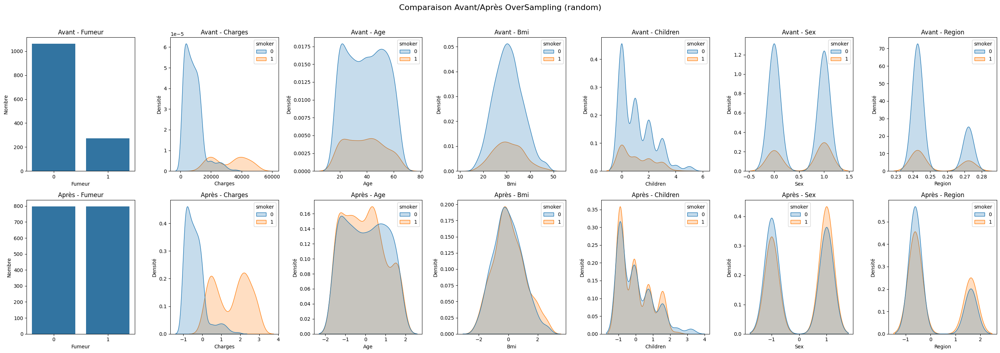

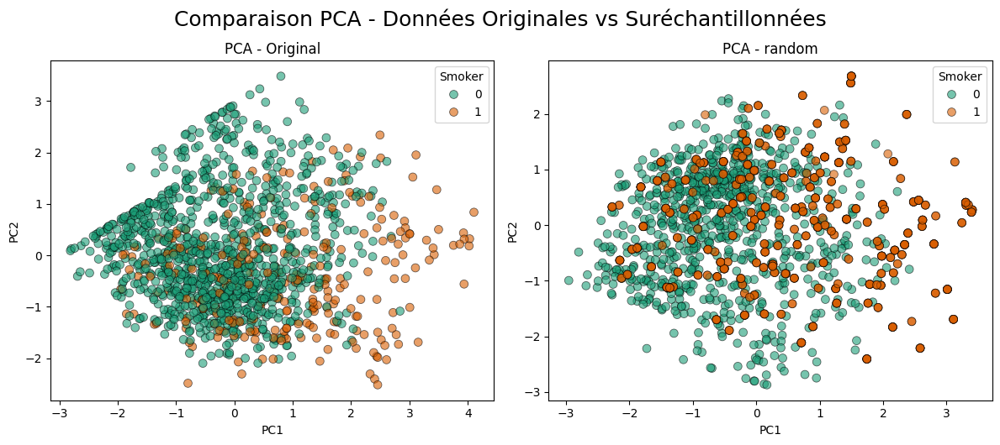


####### COMPARAISON PERFORMANCE - MÉTHODE : RANDOM #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.944792973651192


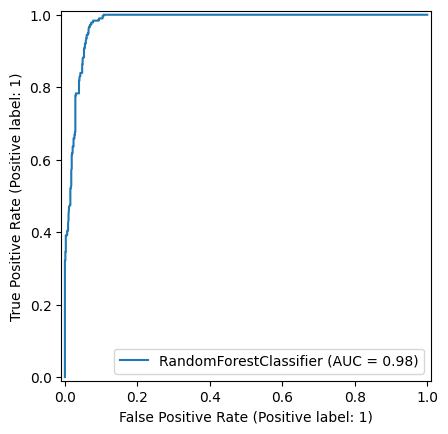

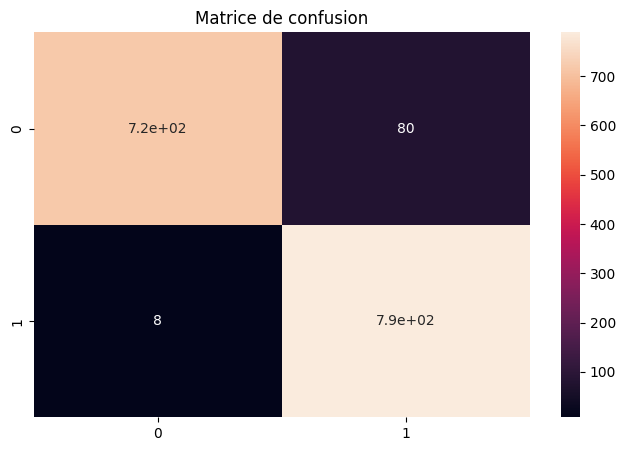

              precision    recall  f1-score   support

           0       0.99      0.90      0.94       797
           1       0.91      0.99      0.95       797

    accuracy                           0.94      1594
   macro avg       0.95      0.94      0.94      1594
weighted avg       0.95      0.94      0.94      1594


=== Entraînement sur données originales ===
Accuracy :  0.9231536926147704


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


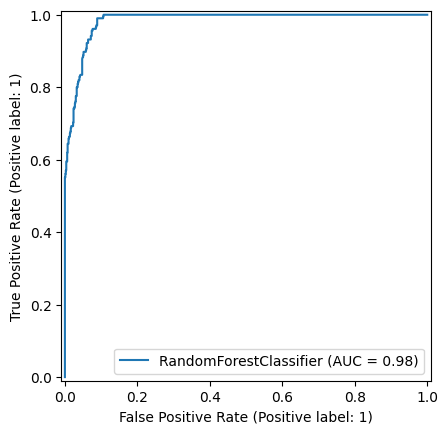

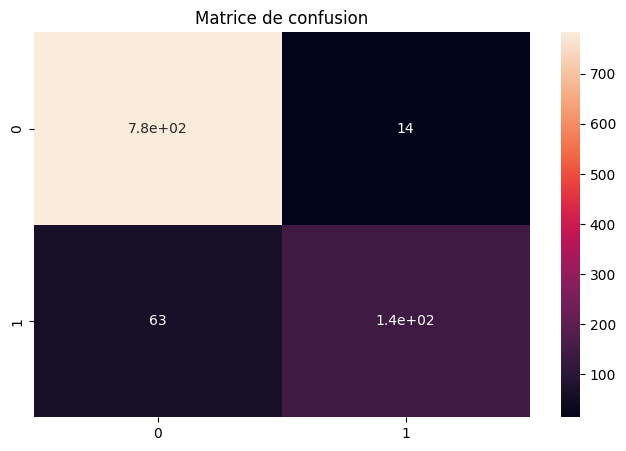

/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


              precision    recall  f1-score   support

           0       0.93      0.98      0.95       797
           1       0.91      0.69      0.79       205

    accuracy                           0.92      1002
   macro avg       0.92      0.84      0.87      1002
weighted avg       0.92      0.92      0.92      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


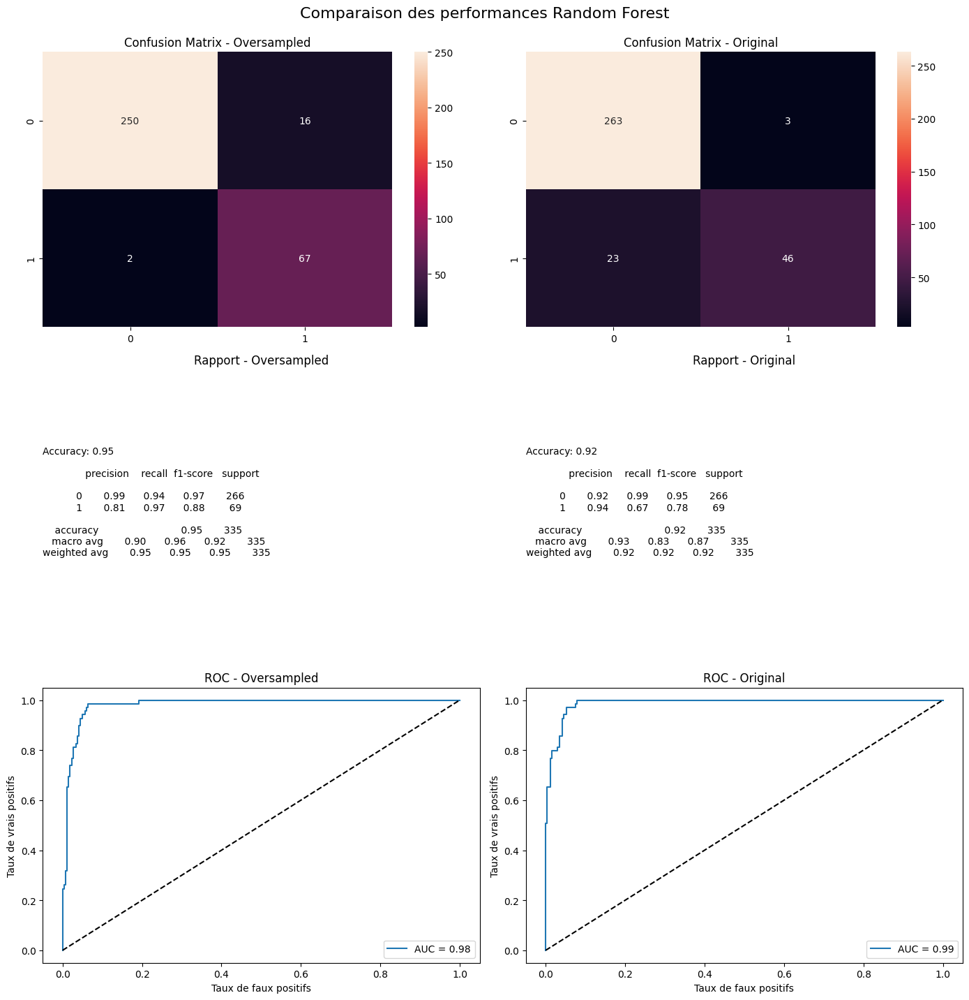

Méthode d'over-sampling :  smote


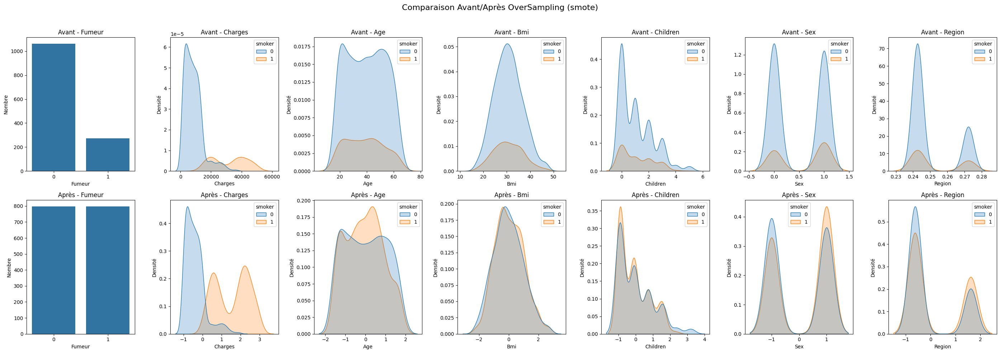

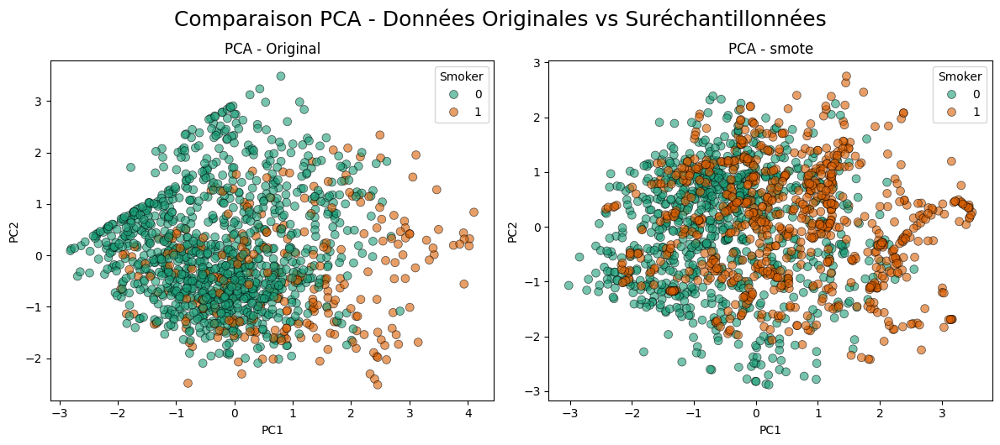


####### COMPARAISON PERFORMANCE - MÉTHODE : SMOTE #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.946047678795483


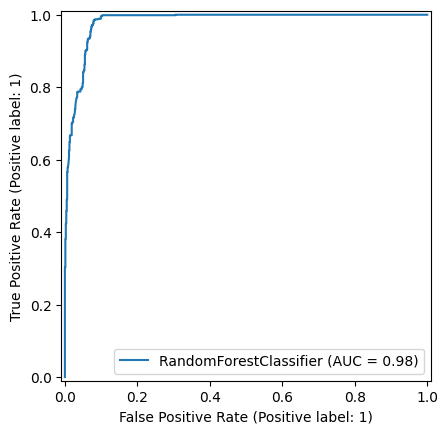

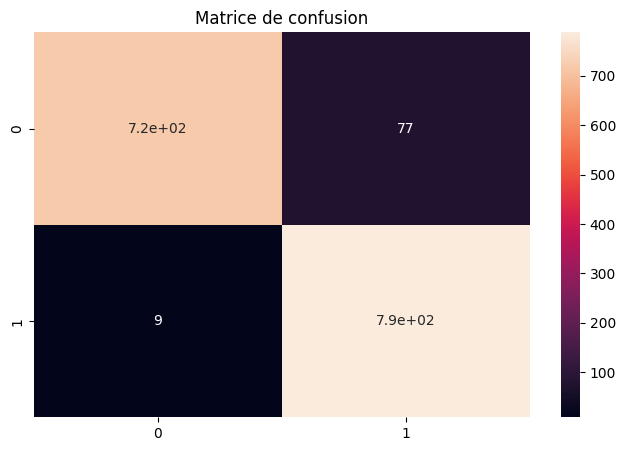

              precision    recall  f1-score   support

           0       0.99      0.90      0.94       797
           1       0.91      0.99      0.95       797

    accuracy                           0.95      1594
   macro avg       0.95      0.95      0.95      1594
weighted avg       0.95      0.95      0.95      1594


=== Entraînement sur données originales ===
Accuracy :  0.9121756487025948


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


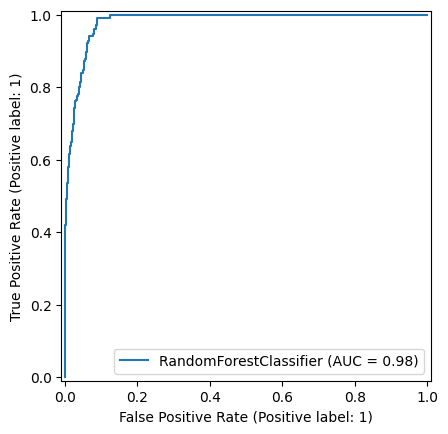

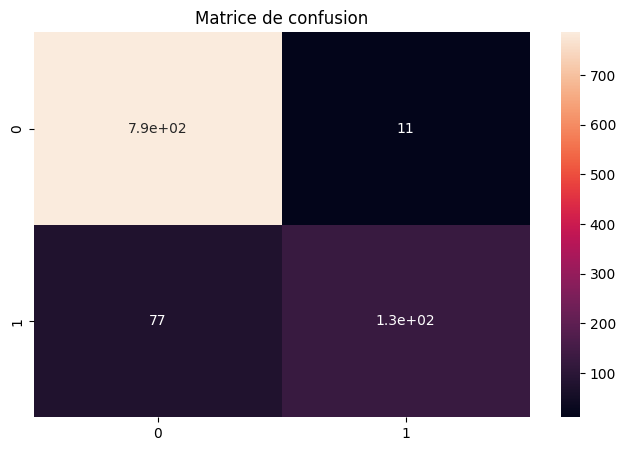

              precision    recall  f1-score   support

           0       0.91      0.99      0.95       797
           1       0.92      0.62      0.74       205

    accuracy                           0.91      1002
   macro avg       0.92      0.81      0.85      1002
weighted avg       0.91      0.91      0.91      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


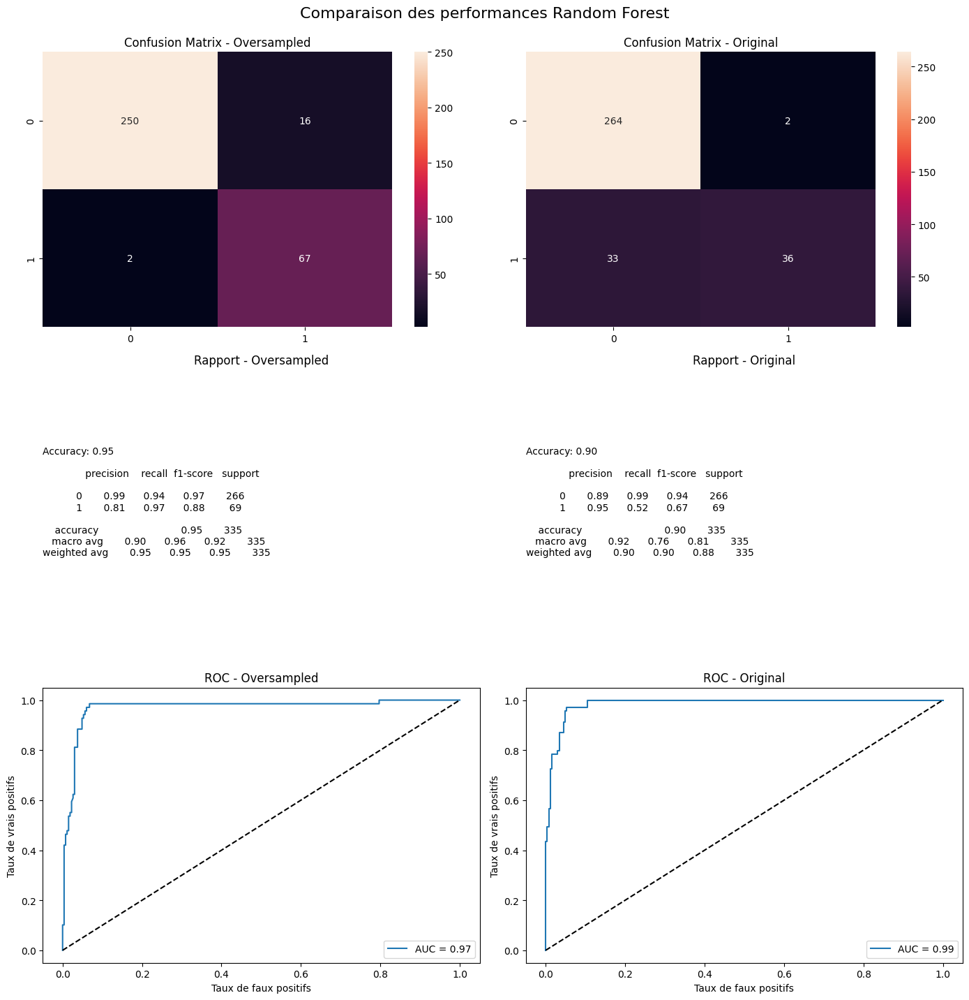

Méthode d'over-sampling :  adasyn


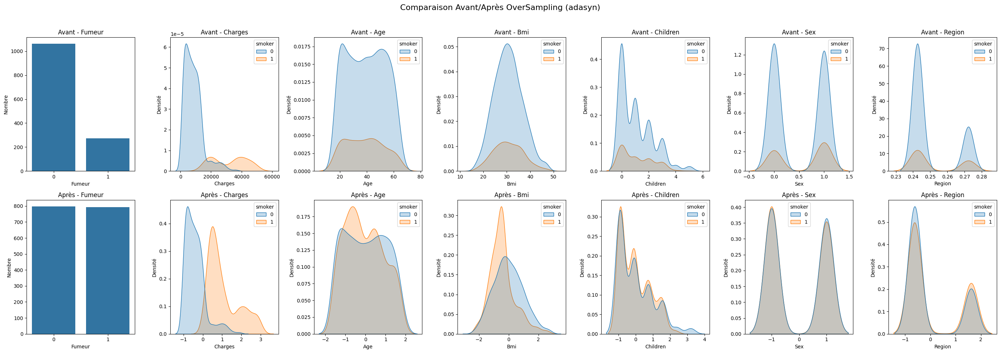

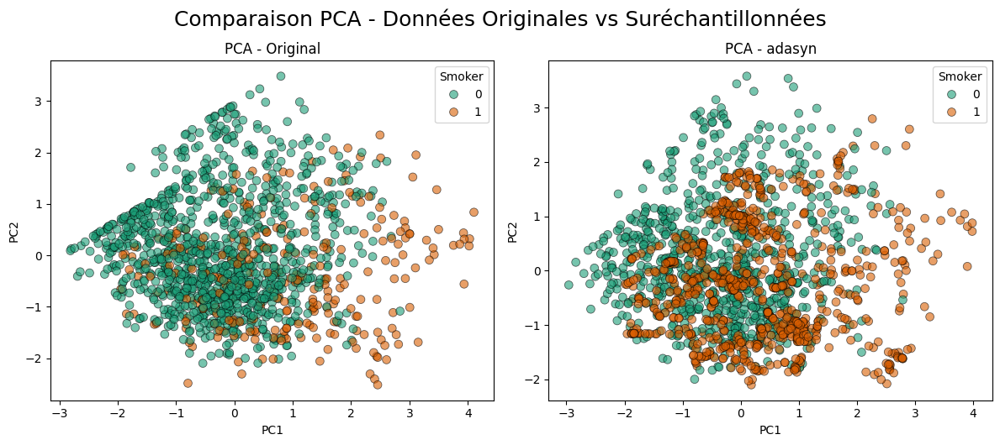


####### COMPARAISON PERFORMANCE - MÉTHODE : ADASYN #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9459119496855346


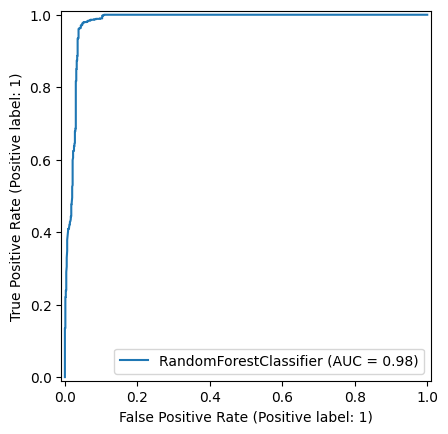

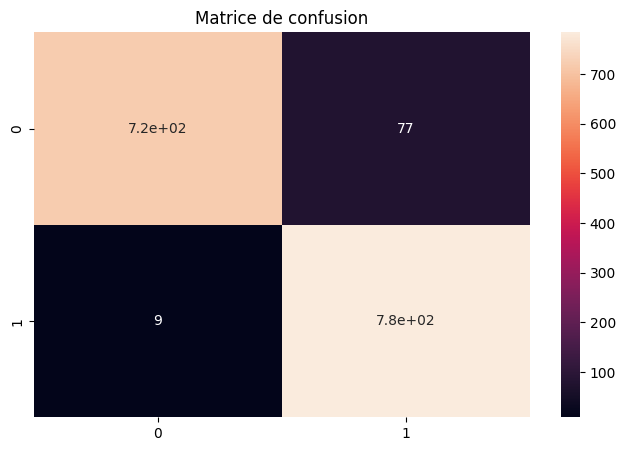

              precision    recall  f1-score   support

           0       0.99      0.90      0.94       797
           1       0.91      0.99      0.95       793

    accuracy                           0.95      1590
   macro avg       0.95      0.95      0.95      1590
weighted avg       0.95      0.95      0.95      1590


=== Entraînement sur données originales ===
Accuracy :  0.9181636726546906


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


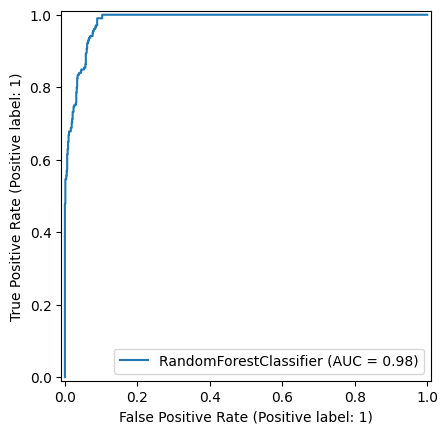

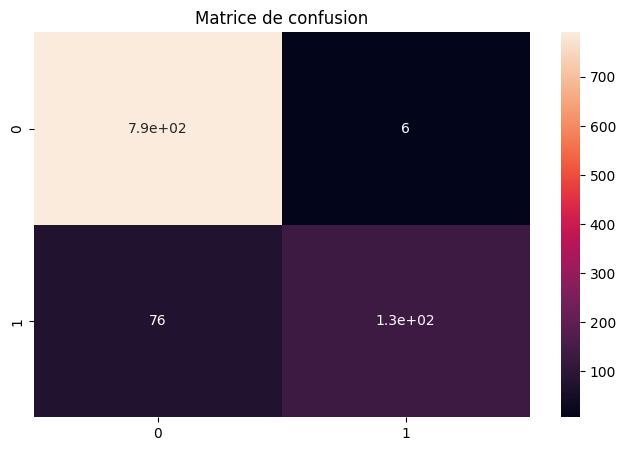

              precision    recall  f1-score   support

           0       0.91      0.99      0.95       797
           1       0.96      0.63      0.76       205

    accuracy                           0.92      1002
   macro avg       0.93      0.81      0.85      1002
weighted avg       0.92      0.92      0.91      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


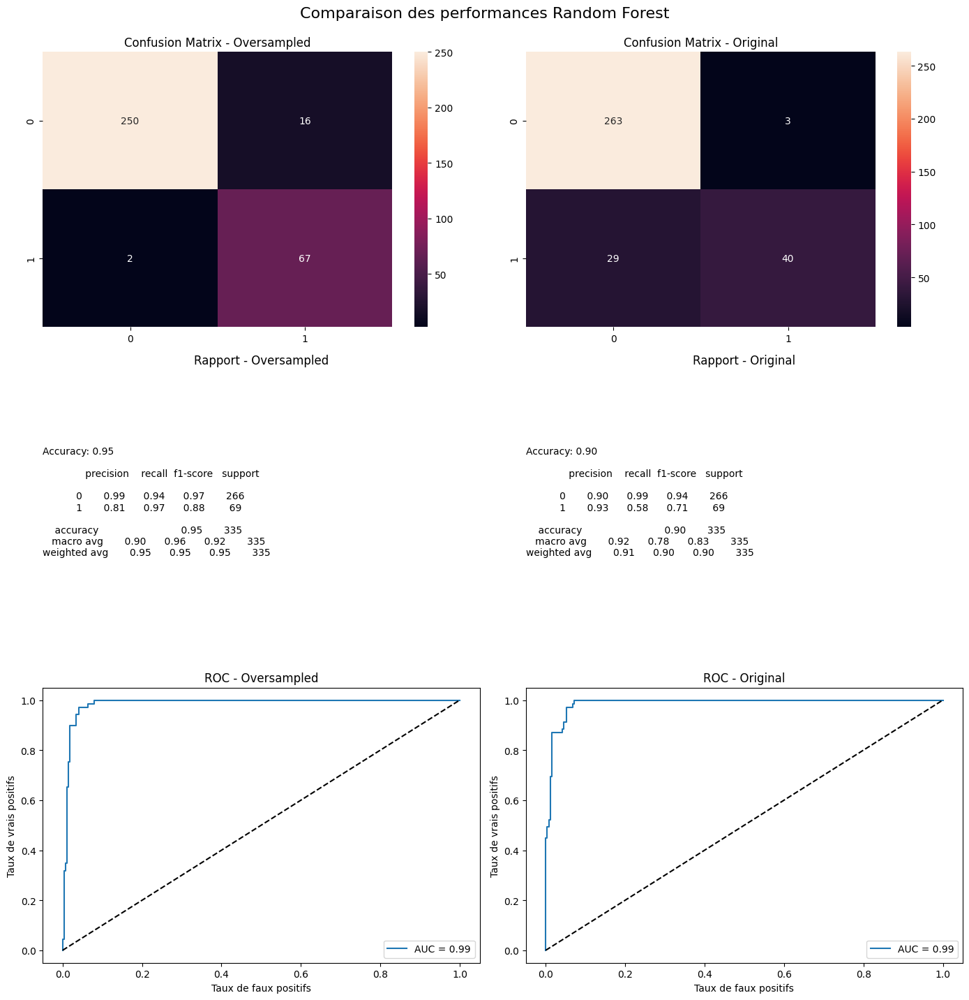

Méthode d'over-sampling :  border1


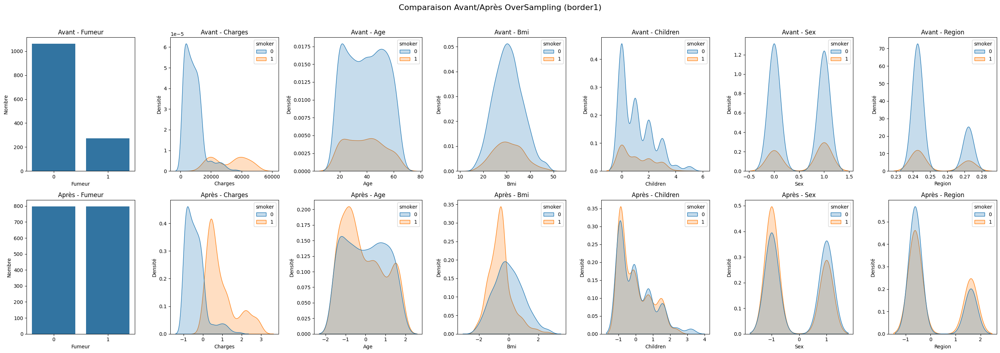

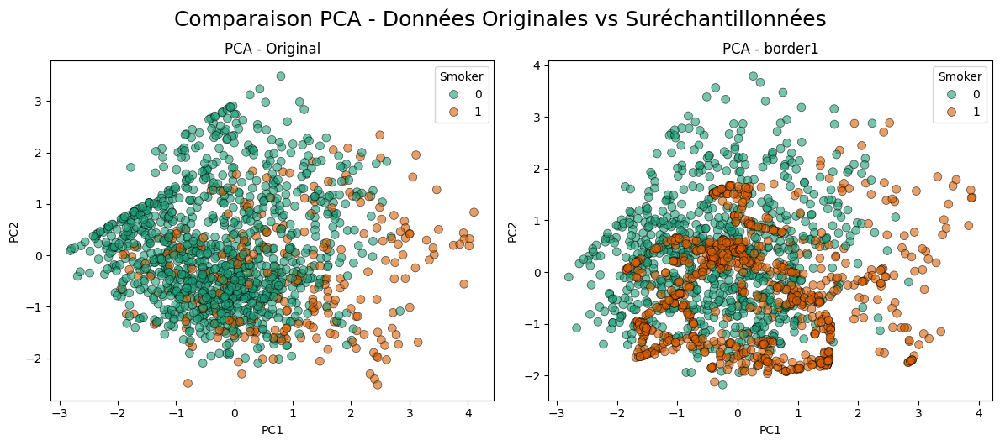


####### COMPARAISON PERFORMANCE - MÉTHODE : BORDER1 #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9441656210790464


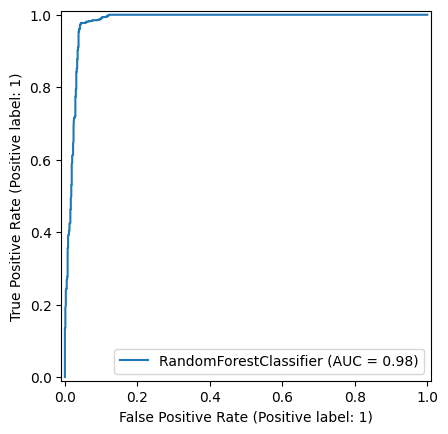

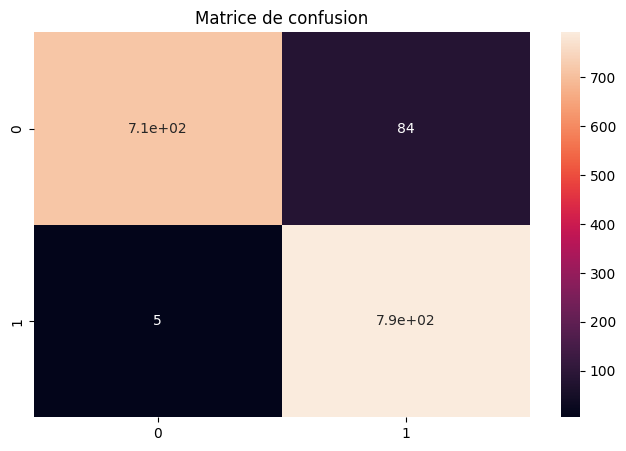

              precision    recall  f1-score   support

           0       0.99      0.89      0.94       797
           1       0.90      0.99      0.95       797

    accuracy                           0.94      1594
   macro avg       0.95      0.94      0.94      1594
weighted avg       0.95      0.94      0.94      1594


=== Entraînement sur données originales ===
Accuracy :  0.844311377245509


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


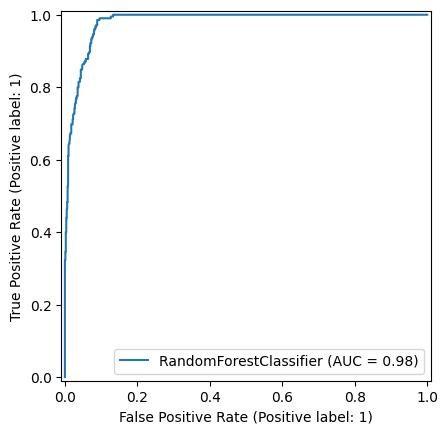

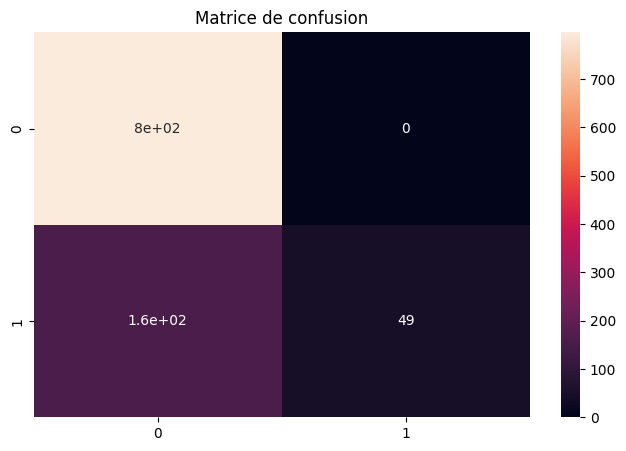

              precision    recall  f1-score   support

           0       0.84      1.00      0.91       797
           1       1.00      0.24      0.39       205

    accuracy                           0.84      1002
   macro avg       0.92      0.62      0.65      1002
weighted avg       0.87      0.84      0.80      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


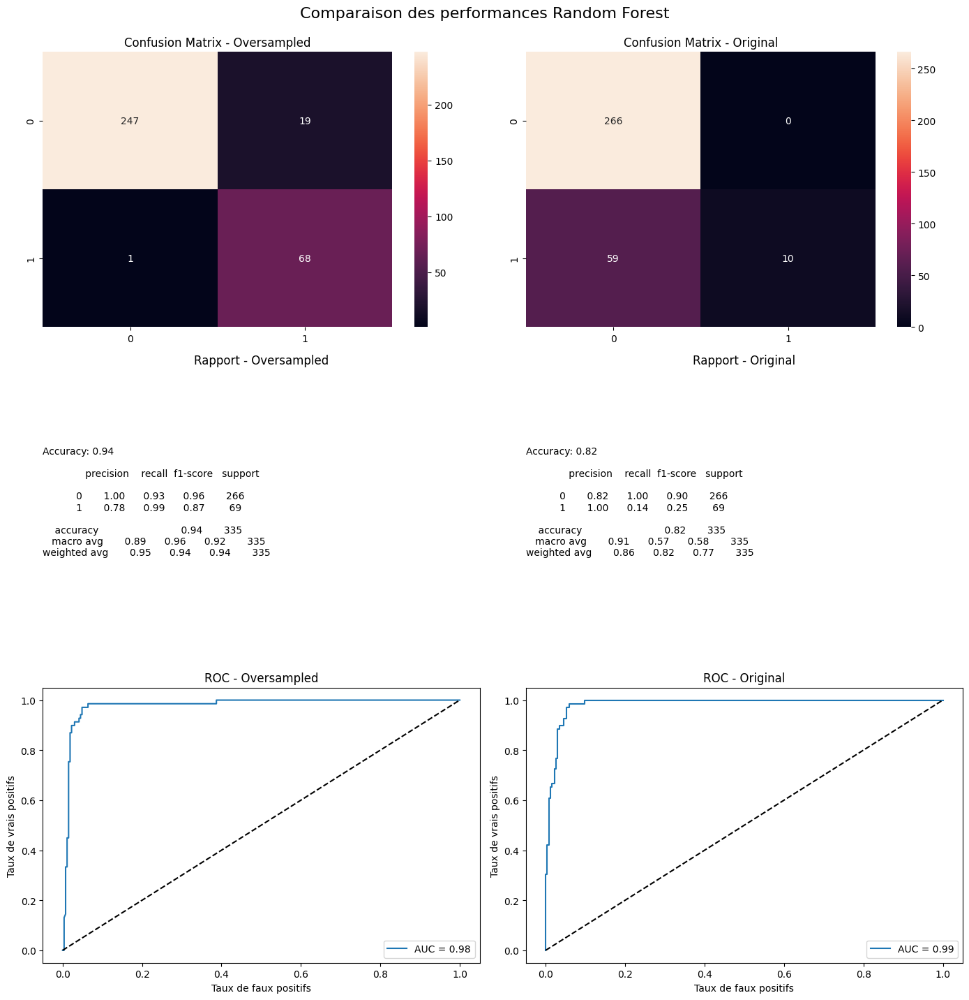

Méthode d'over-sampling :  border2


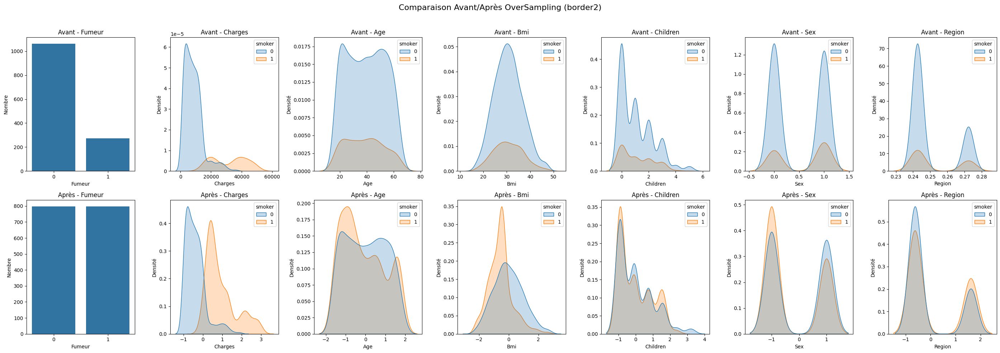

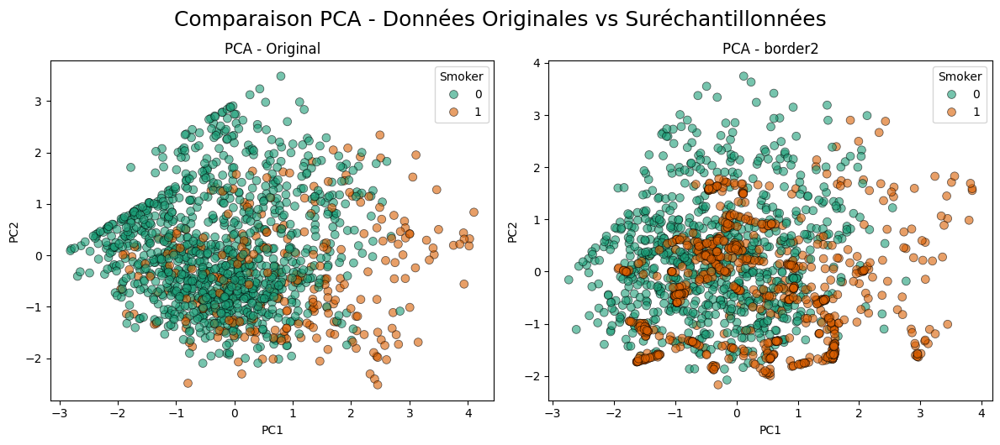


####### COMPARAISON PERFORMANCE - MÉTHODE : BORDER2 #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9322459222082811


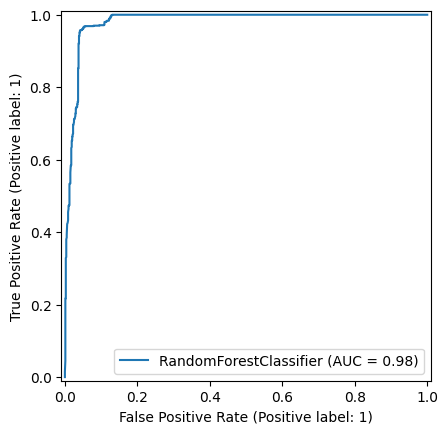

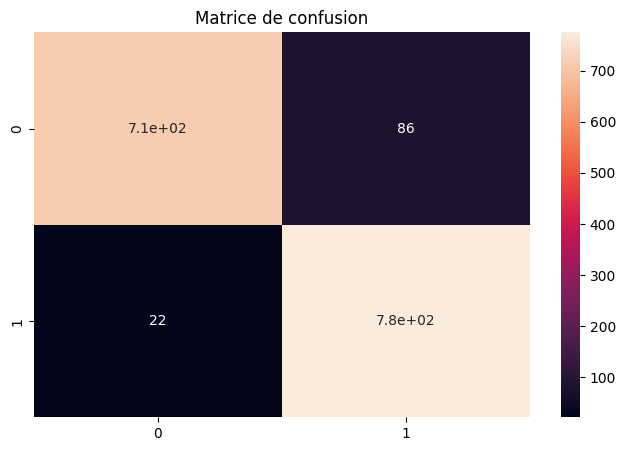

              precision    recall  f1-score   support

           0       0.97      0.89      0.93       797
           1       0.90      0.97      0.93       797

    accuracy                           0.93      1594
   macro avg       0.94      0.93      0.93      1594
weighted avg       0.94      0.93      0.93      1594


=== Entraînement sur données originales ===
Accuracy :  0.9051896207584831


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


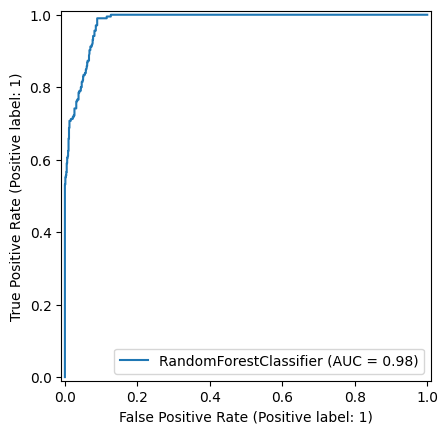

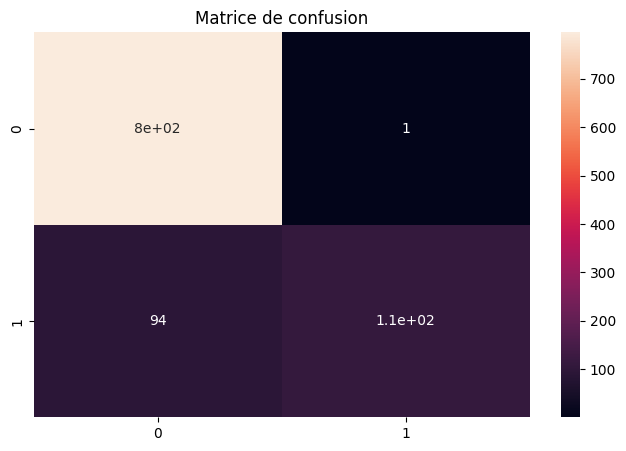

              precision    recall  f1-score   support

           0       0.89      1.00      0.94       797
           1       0.99      0.54      0.70       205

    accuracy                           0.91      1002
   macro avg       0.94      0.77      0.82      1002
weighted avg       0.91      0.91      0.89      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


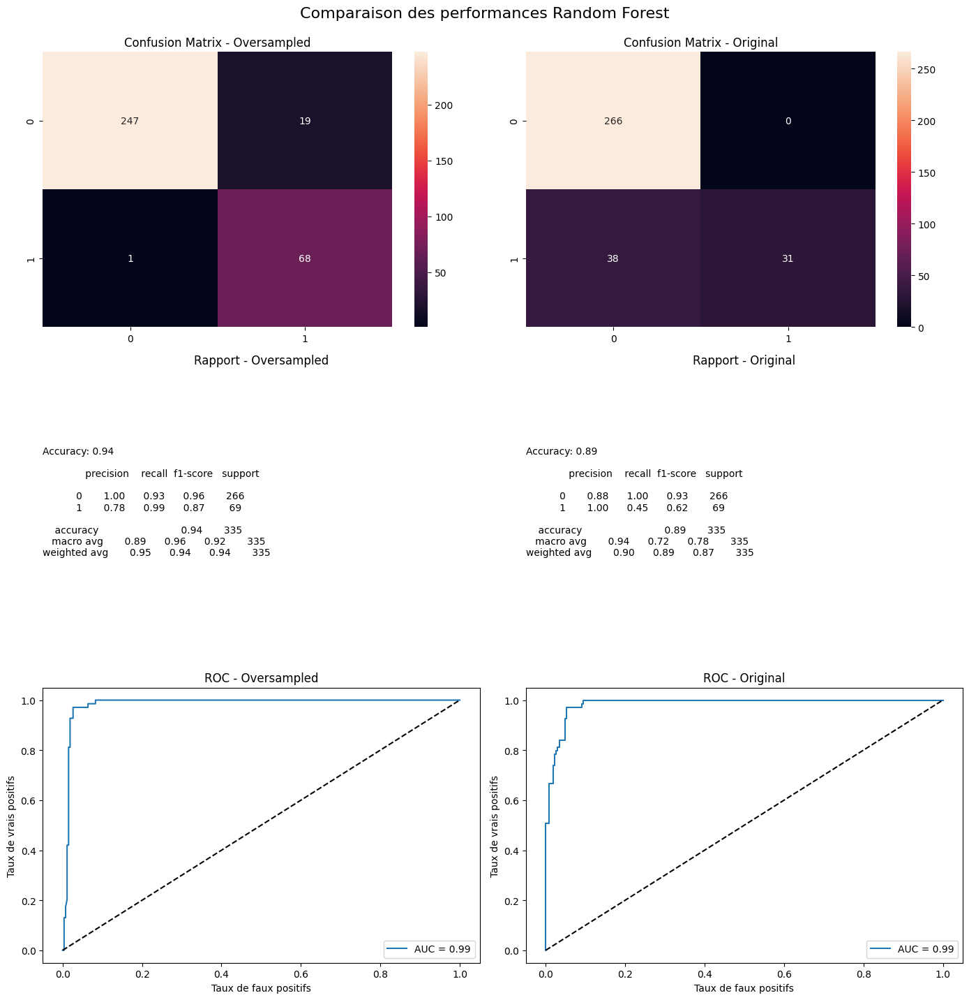

Méthode d'over-sampling :  svm


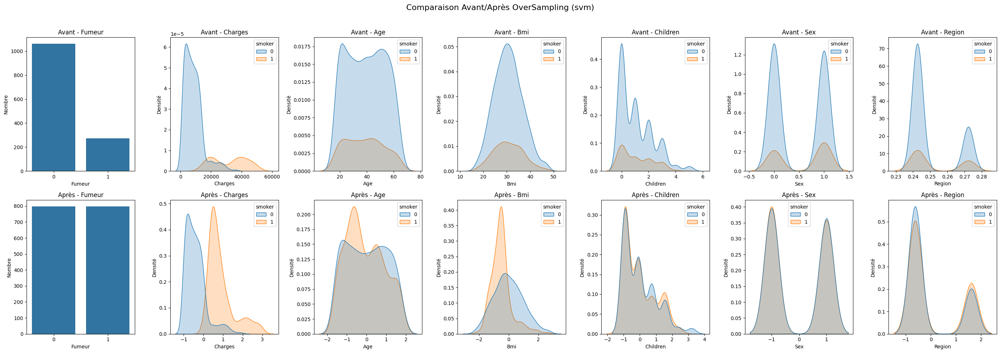

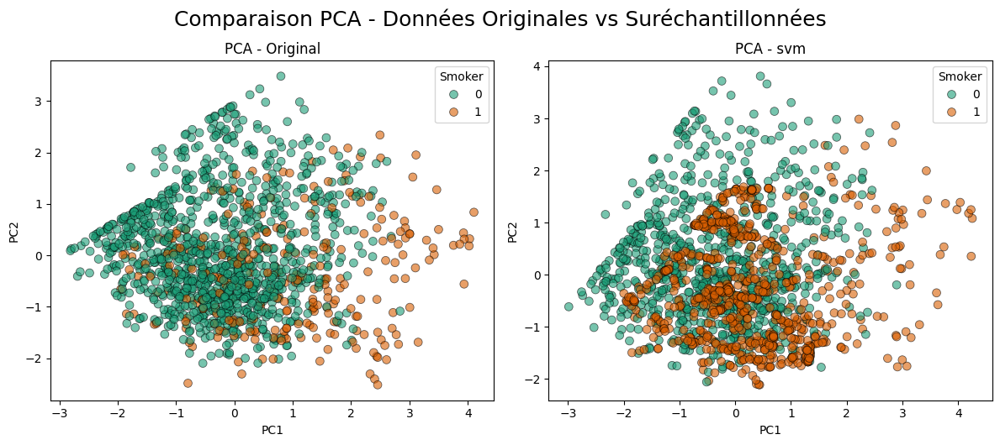


####### COMPARAISON PERFORMANCE - MÉTHODE : SVM #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9454203262233375


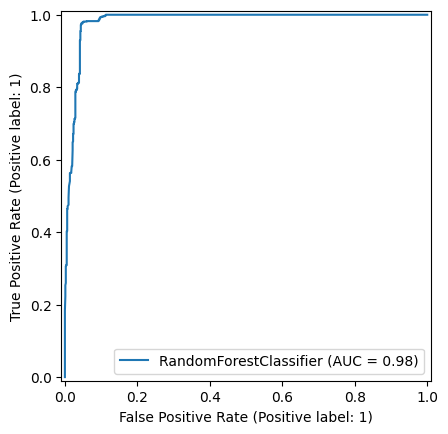

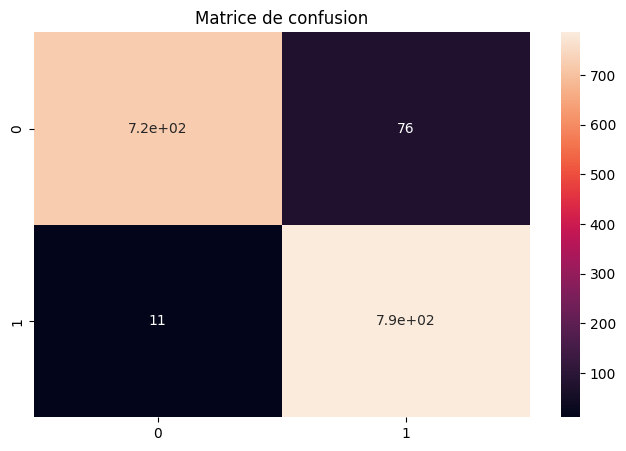

              precision    recall  f1-score   support

           0       0.98      0.90      0.94       797
           1       0.91      0.99      0.95       797

    accuracy                           0.95      1594
   macro avg       0.95      0.95      0.95      1594
weighted avg       0.95      0.95      0.95      1594


=== Entraînement sur données originales ===
Accuracy :  0.9271457085828343


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


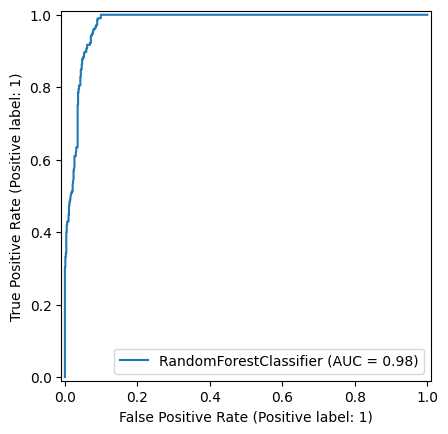

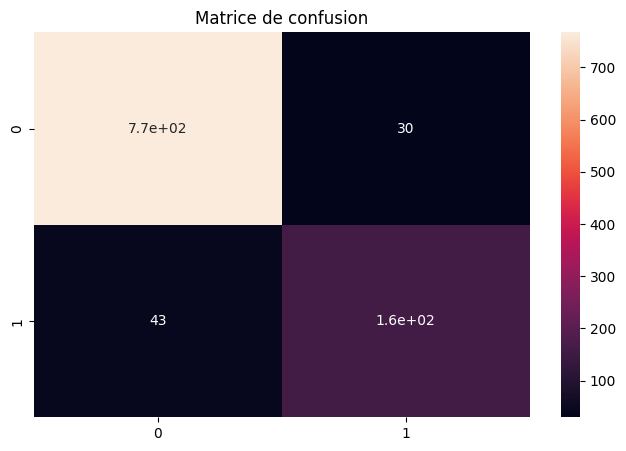

              precision    recall  f1-score   support

           0       0.95      0.96      0.95       797
           1       0.84      0.79      0.82       205

    accuracy                           0.93      1002
   macro avg       0.90      0.88      0.89      1002
weighted avg       0.93      0.93      0.93      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


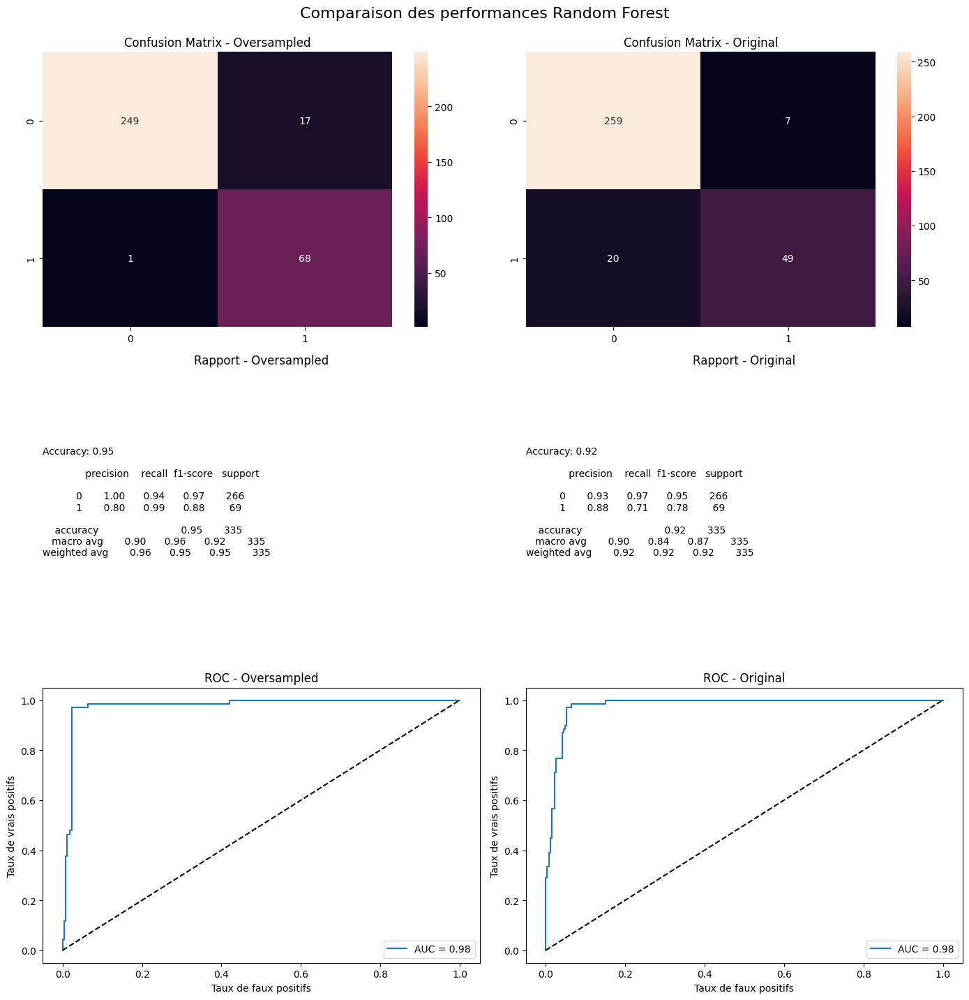

In [17]:
resampled_data_dict = {}

for oversampler in oversampler_dict.keys():
    print("Méthode d'over-sampling : ", oversampler)
    
    # Resampling des données
    X_resampled, y_resampled = oversampler_dict[oversampler].fit_resample(X_train, y_train)

    # Conversion en DataFrame si nécessaire
    if not isinstance(X_resampled, pd.DataFrame):
        X_resampled = pd.DataFrame(X_resampled, columns=X.columns)

    if isinstance(y_resampled, pd.DataFrame):
        y_resampled = y_resampled.iloc[:, 0]
    else:
        y_resampled = pd.Series(y_resampled, name='smoker')
    
    data_resampled = pd.concat([X_resampled, y_resampled], axis=1)

    # Sauvegarde pour éventuelle réutilisation
    resampled_data_dict[oversampler] = data_resampled
    
    # Visualisation comparative
    compare_smoker_distribution(data, data_resampled, title_suffix=f"({oversampler})")
    compare_pca_oversampling(data, {oversampler: data_resampled})

    # Comparaison de performance tout de suite après la visualisation
    print(f"\n####### COMPARAISON PERFORMANCE - MÉTHODE : {oversampler.upper()} #######")
    X_train_resampled = data_resampled.drop(columns='smoker')
    y_train_resampled = data_resampled['smoker']

    compare_random_forest_performance(
        X_train_orig=X_train, y_train_orig=y_train,
        X_train_res=X_train_resampled, y_train_res=y_train_resampled,
        X_test=X_test, y_test=y_test
    )

## Naives bayes
### requilibrage et control de l'impact sur le modeles 

Méthode d'over-sampling :  random


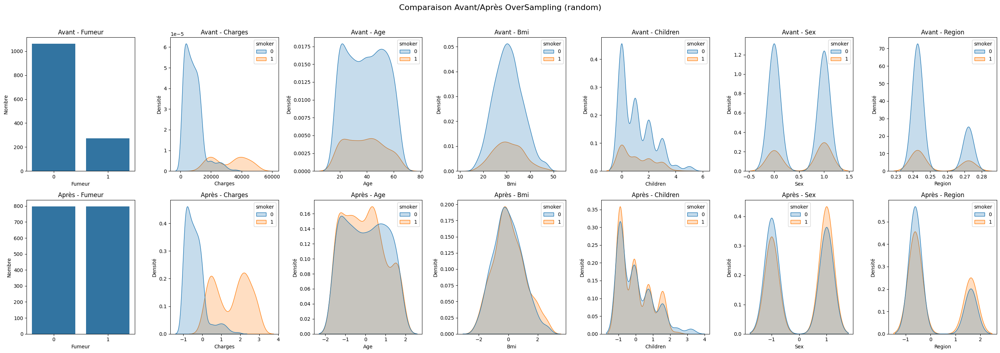

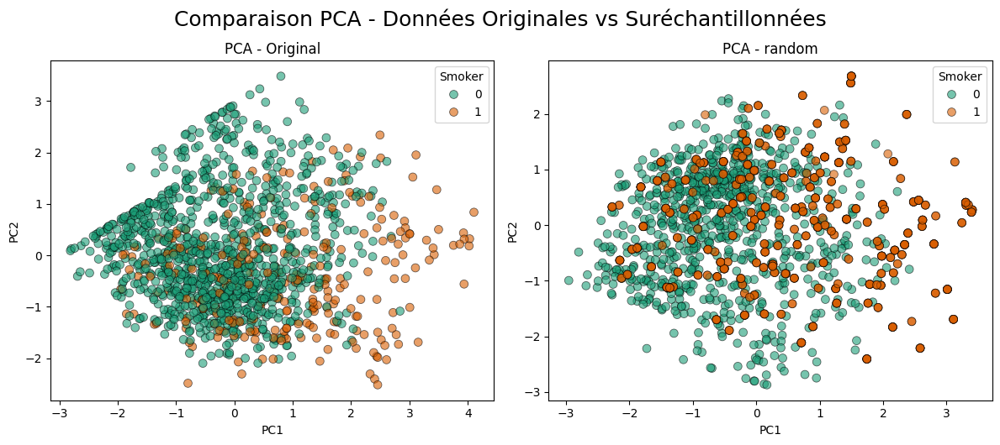


####### COMPARAISON PERFORMANCE - MÉTHODE : RANDOM #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.8920953575909661


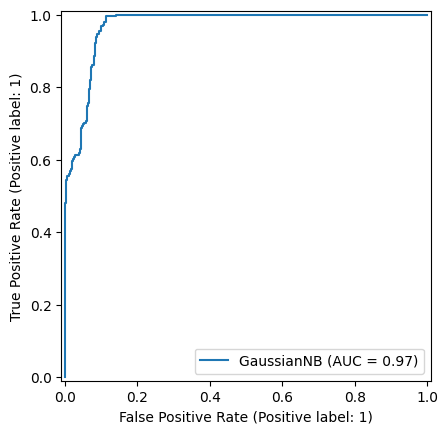

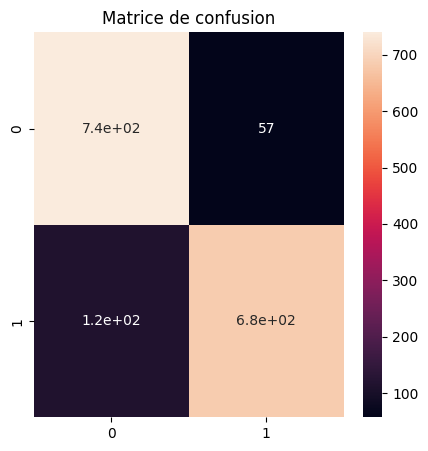

              precision    recall  f1-score   support

           0       0.87      0.93      0.90       797
           1       0.92      0.86      0.89       797

    accuracy                           0.89      1594
   macro avg       0.89      0.89      0.89      1594
weighted avg       0.89      0.89      0.89      1594


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


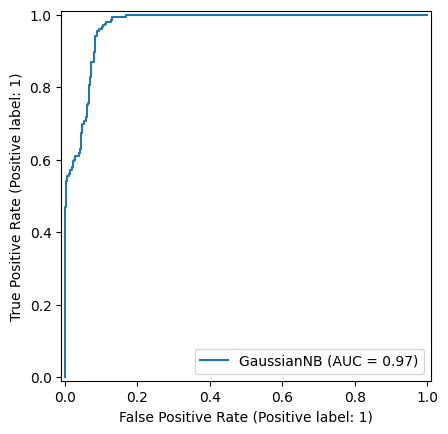

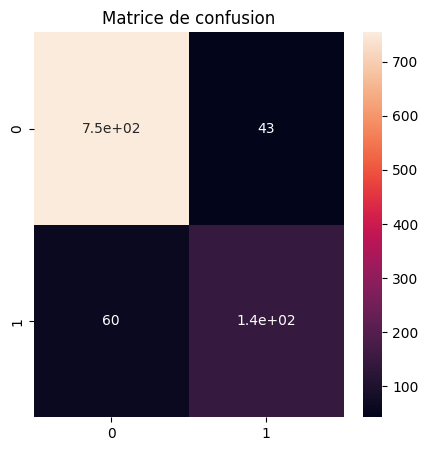

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


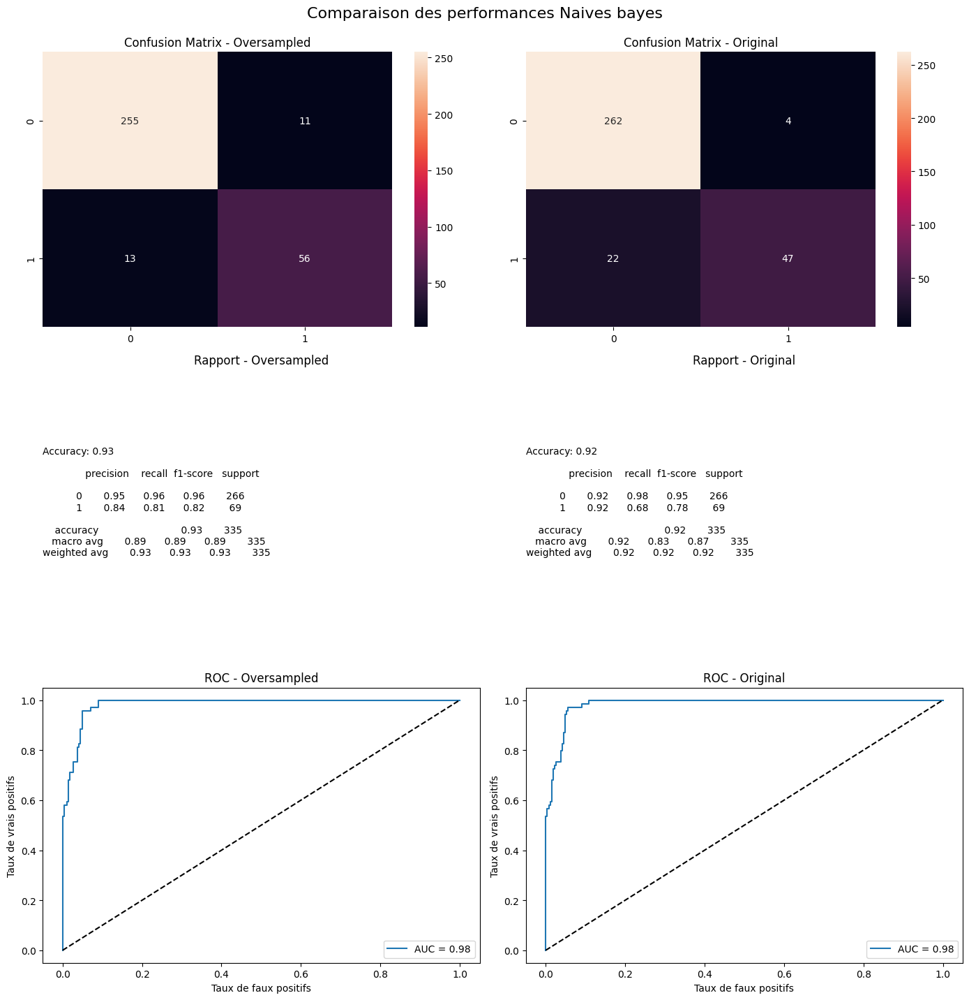

Méthode d'over-sampling :  smote


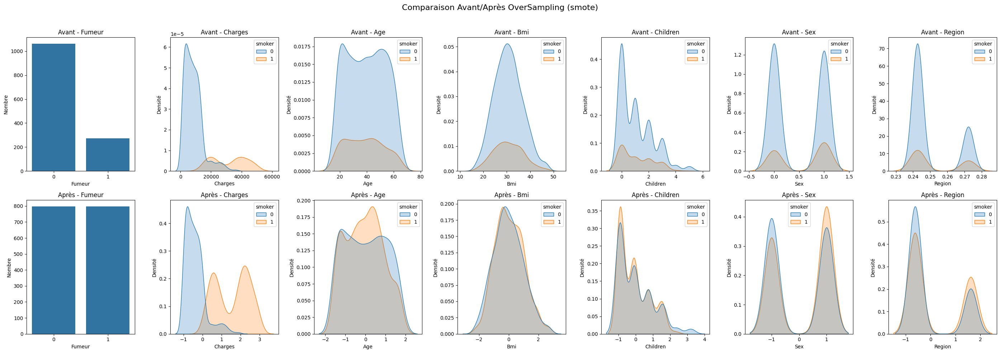

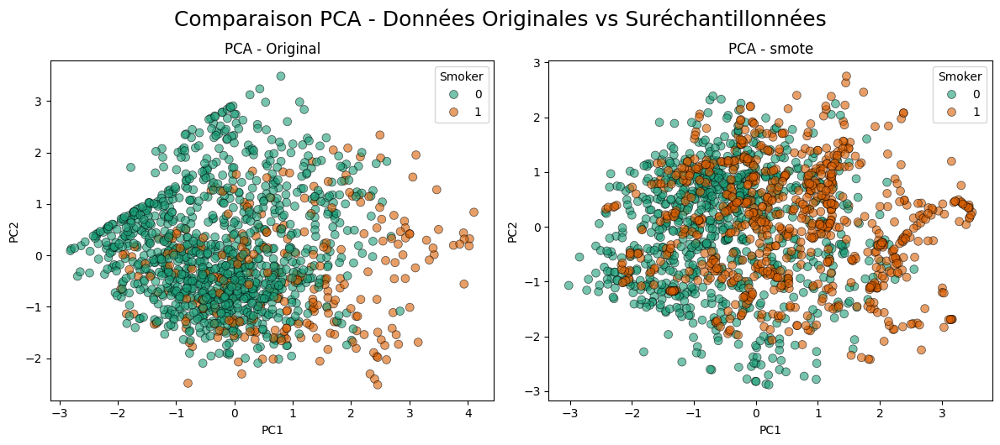


####### COMPARAISON PERFORMANCE - MÉTHODE : SMOTE #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.8983688833124216


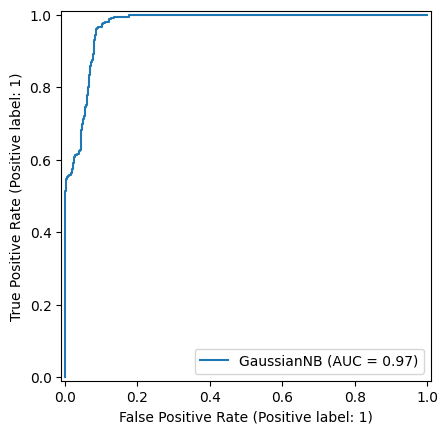

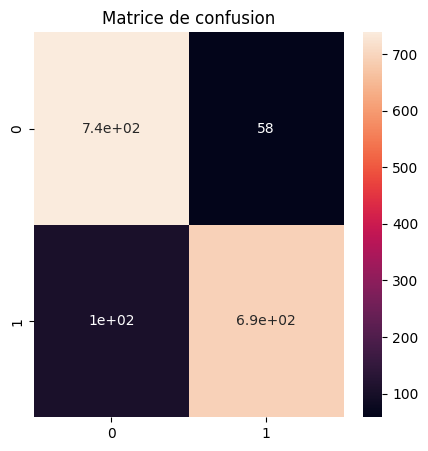

              precision    recall  f1-score   support

           0       0.88      0.93      0.90       797
           1       0.92      0.87      0.90       797

    accuracy                           0.90      1594
   macro avg       0.90      0.90      0.90      1594
weighted avg       0.90      0.90      0.90      1594


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


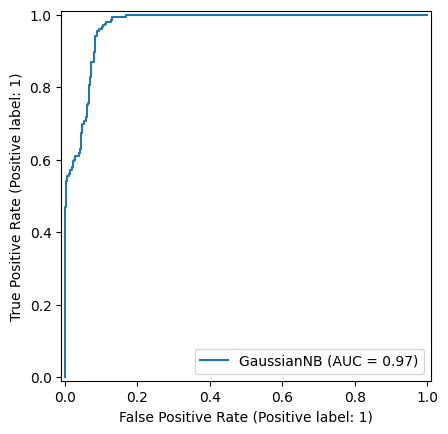

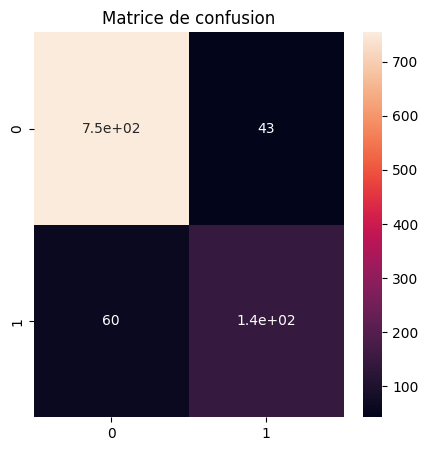

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


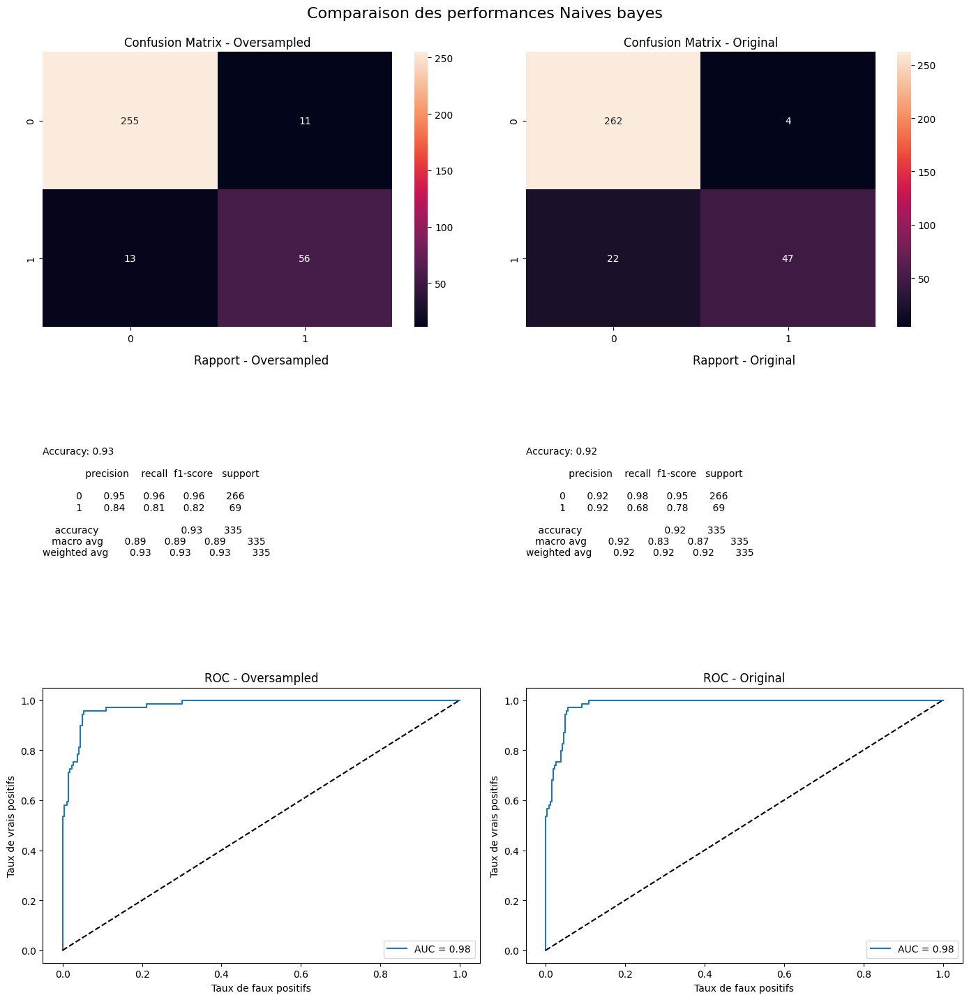

Méthode d'over-sampling :  adasyn


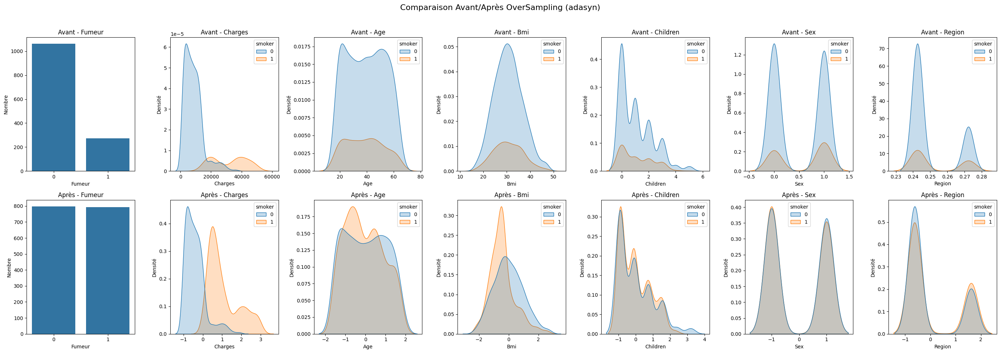

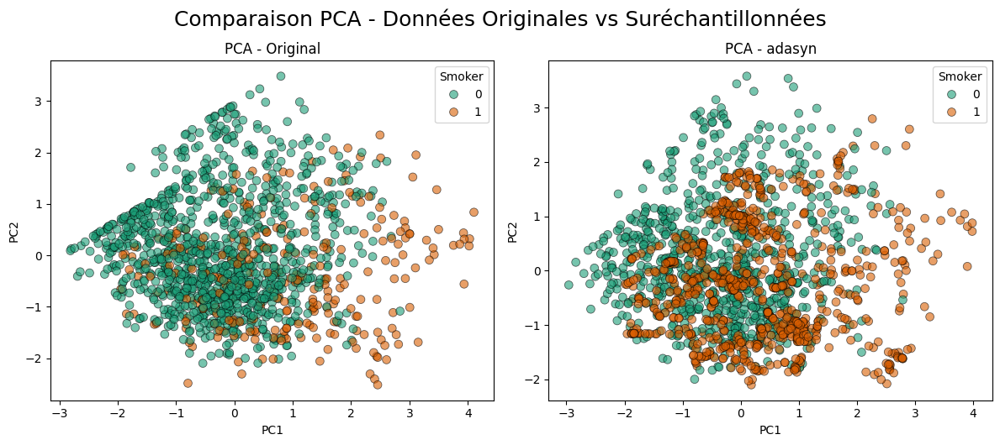


####### COMPARAISON PERFORMANCE - MÉTHODE : ADASYN #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9327044025157233


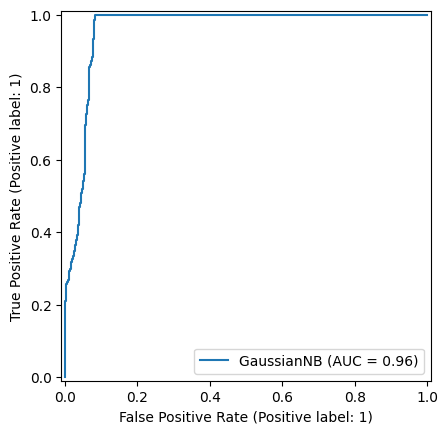

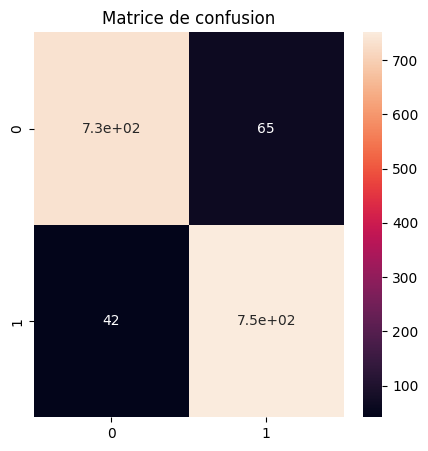

              precision    recall  f1-score   support

           0       0.95      0.92      0.93       797
           1       0.92      0.95      0.93       793

    accuracy                           0.93      1590
   macro avg       0.93      0.93      0.93      1590
weighted avg       0.93      0.93      0.93      1590


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


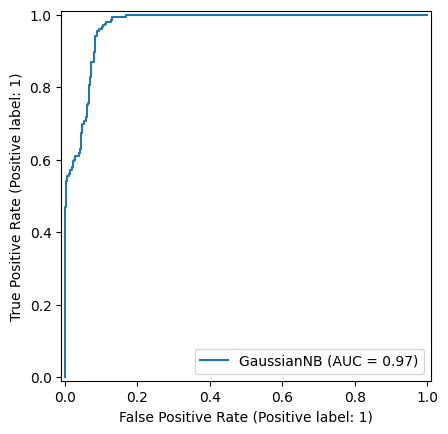

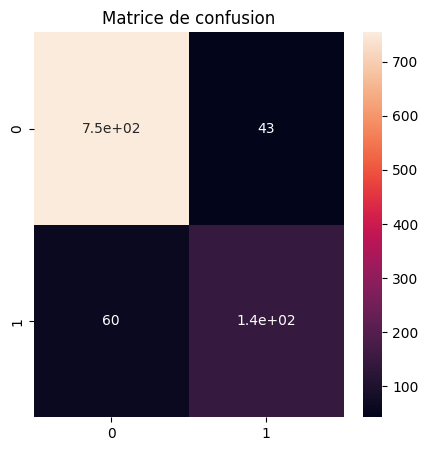

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


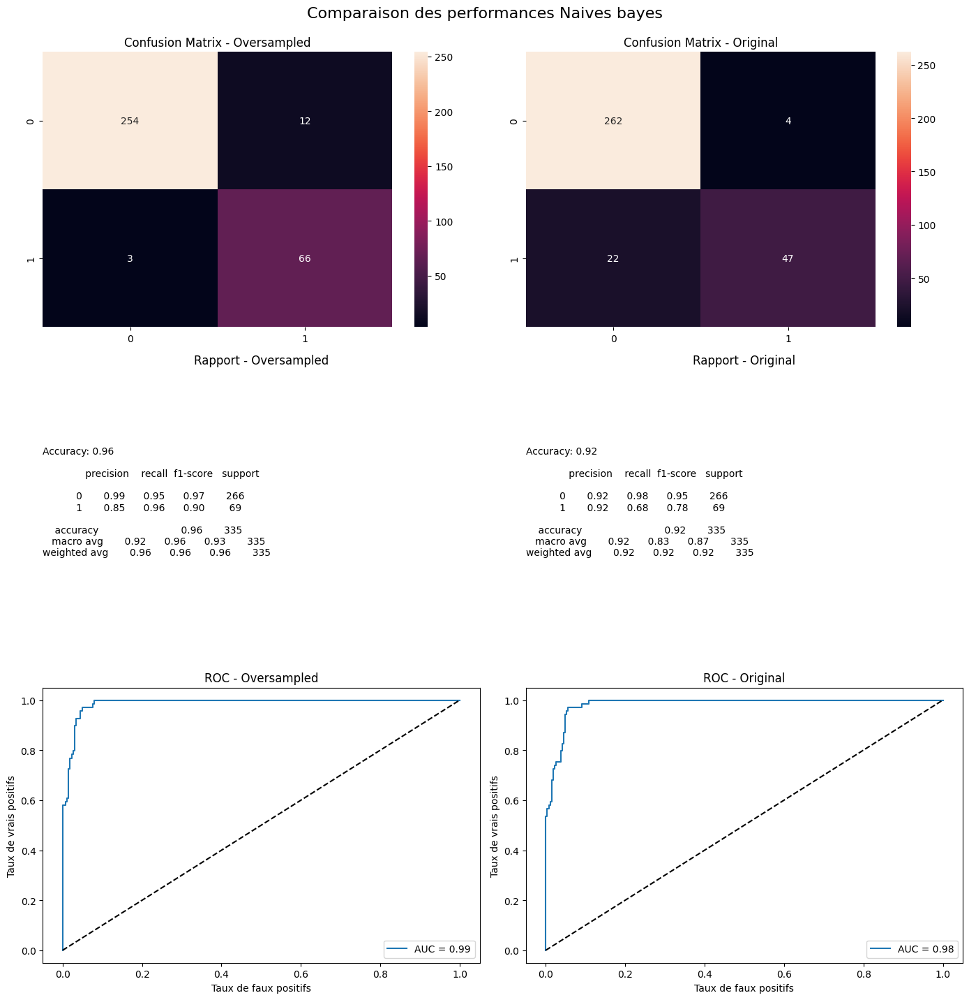

Méthode d'over-sampling :  border1


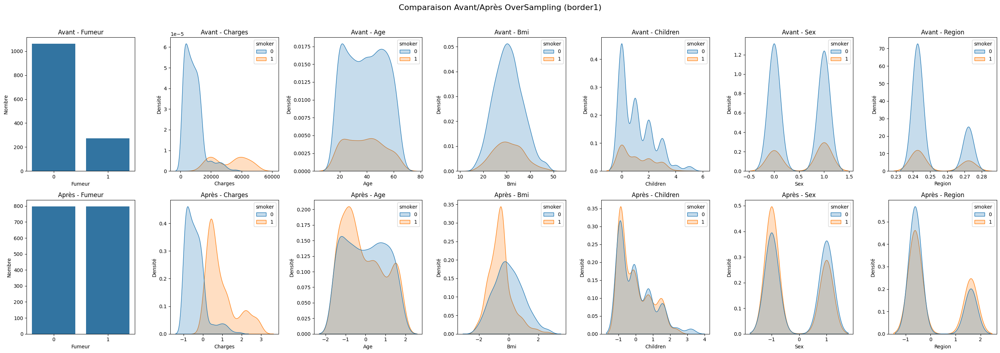

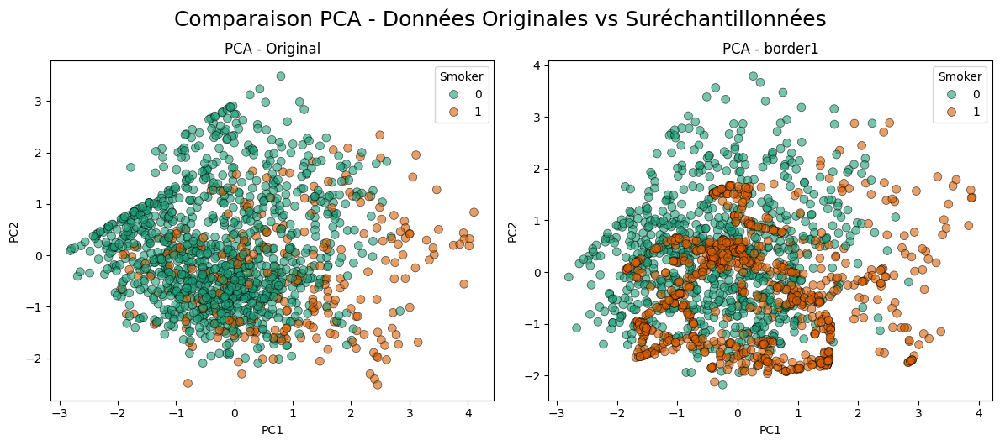


####### COMPARAISON PERFORMANCE - MÉTHODE : BORDER1 #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9466750313676286


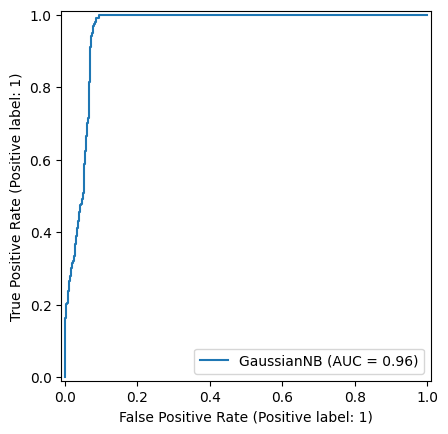

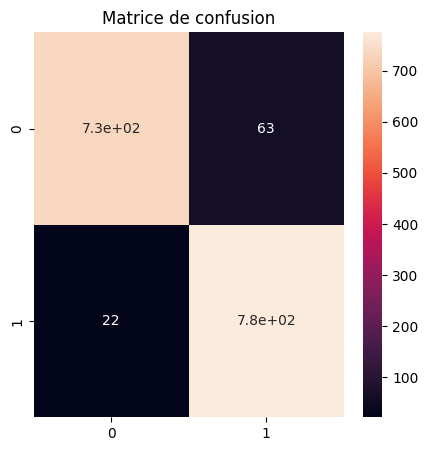

              precision    recall  f1-score   support

           0       0.97      0.92      0.95       797
           1       0.92      0.97      0.95       797

    accuracy                           0.95      1594
   macro avg       0.95      0.95      0.95      1594
weighted avg       0.95      0.95      0.95      1594


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


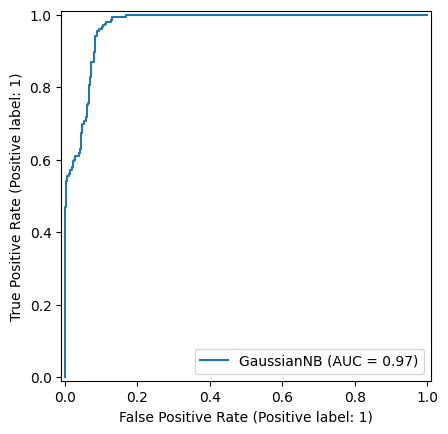

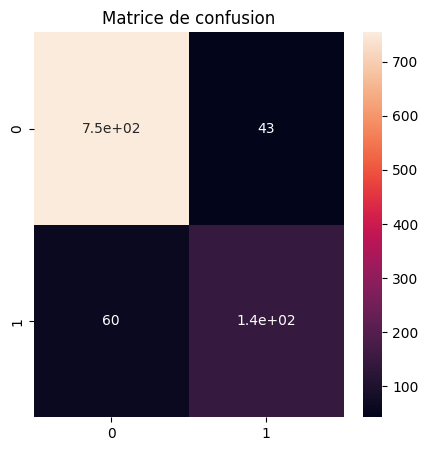

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


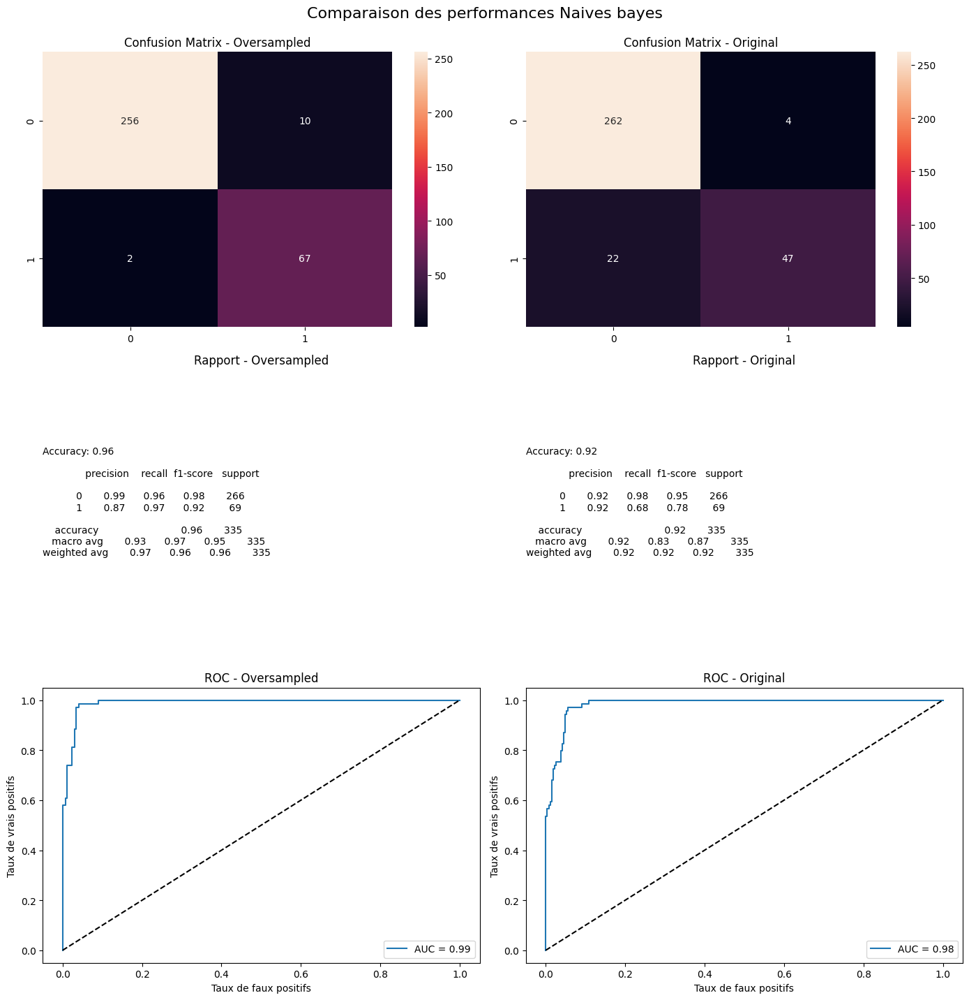

Méthode d'over-sampling :  border2


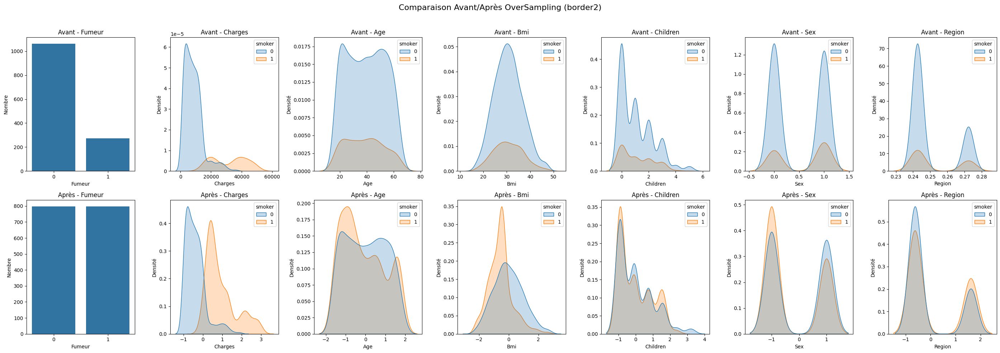

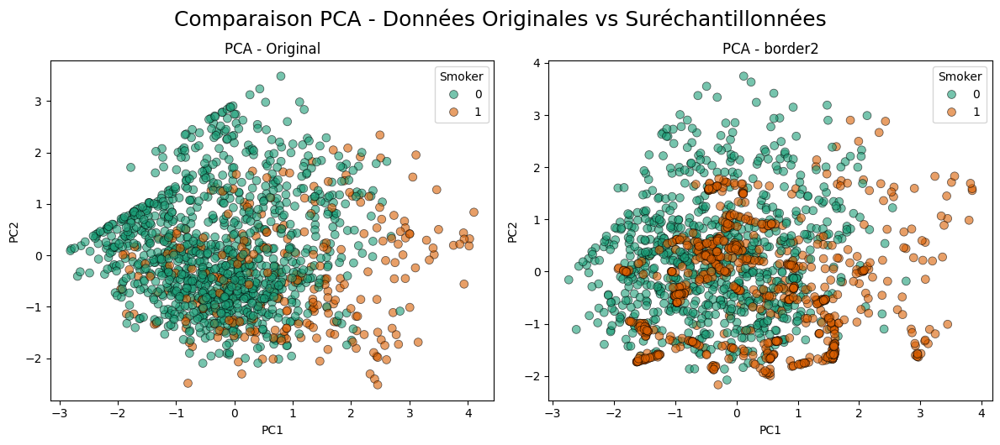


####### COMPARAISON PERFORMANCE - MÉTHODE : BORDER2 #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.939146800501882


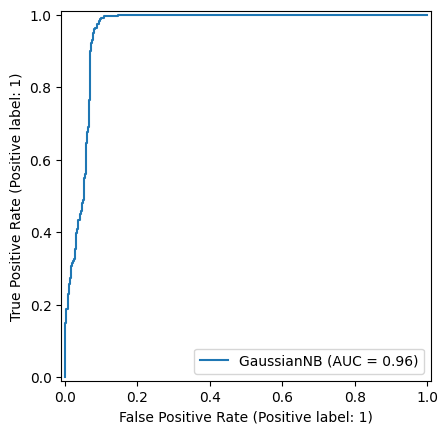

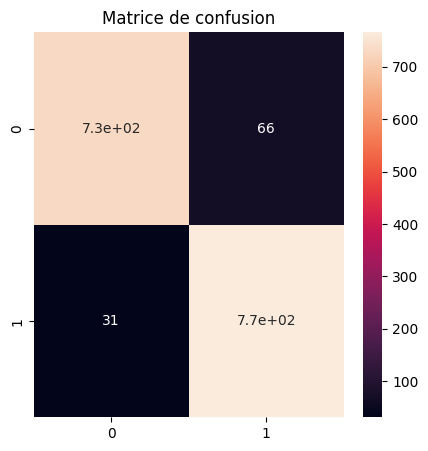

              precision    recall  f1-score   support

           0       0.96      0.92      0.94       797
           1       0.92      0.96      0.94       797

    accuracy                           0.94      1594
   macro avg       0.94      0.94      0.94      1594
weighted avg       0.94      0.94      0.94      1594


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


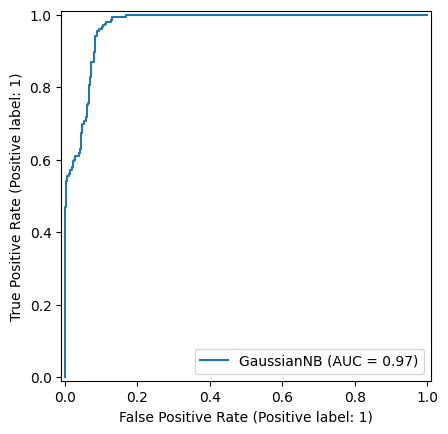

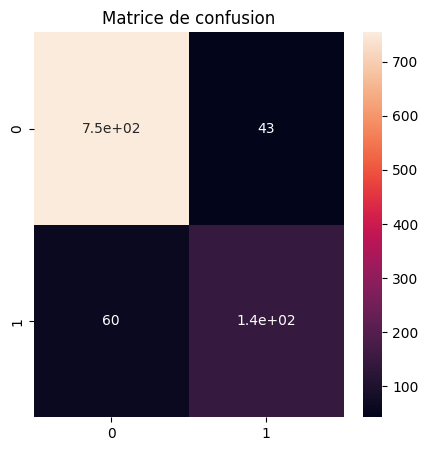

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


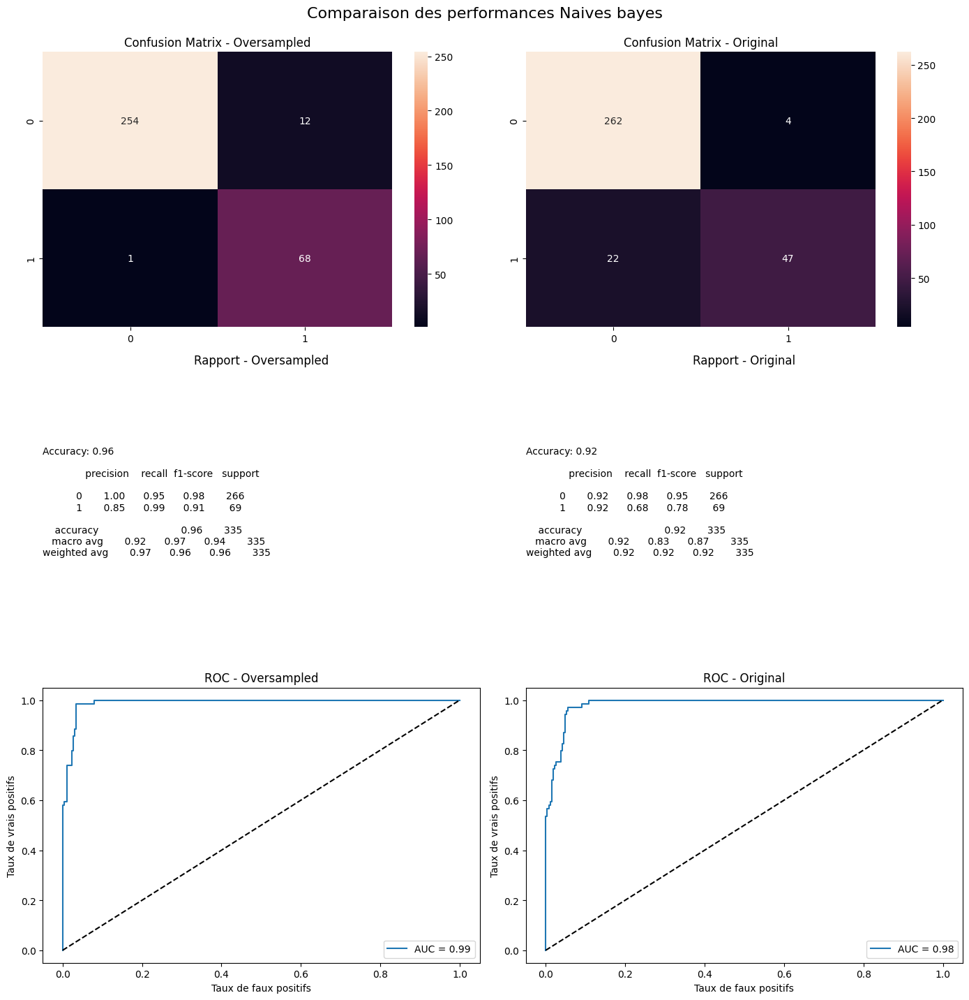

Méthode d'over-sampling :  svm


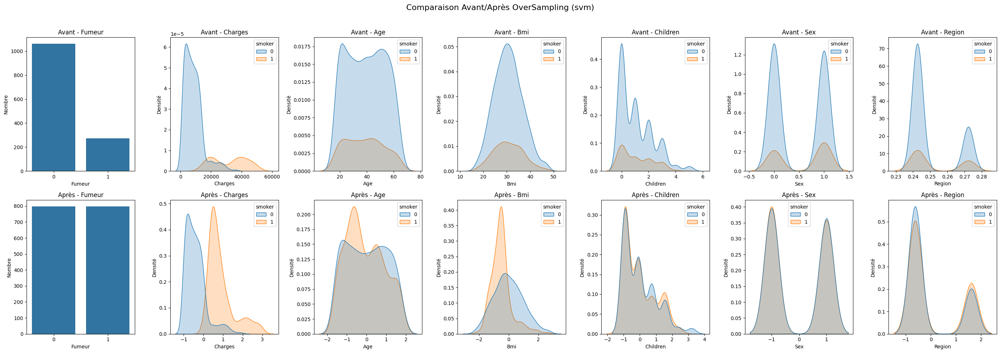

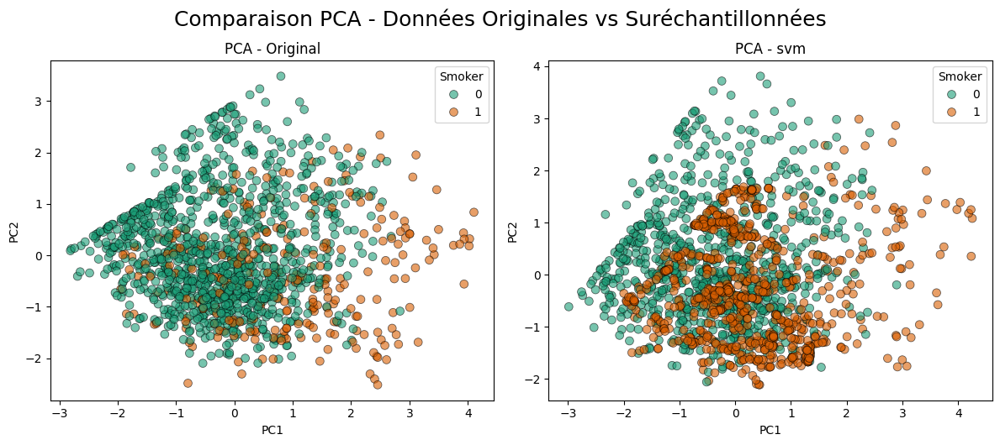


####### COMPARAISON PERFORMANCE - MÉTHODE : SVM #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9498117942283564


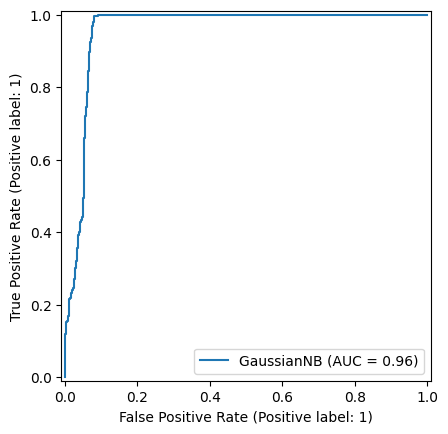

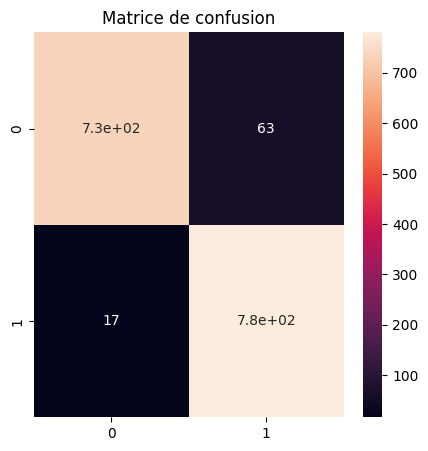

              precision    recall  f1-score   support

           0       0.98      0.92      0.95       797
           1       0.93      0.98      0.95       797

    accuracy                           0.95      1594
   macro avg       0.95      0.95      0.95      1594
weighted avg       0.95      0.95      0.95      1594


=== Entraînement sur données originales ===
Accuracy :  0.8972055888223552


/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


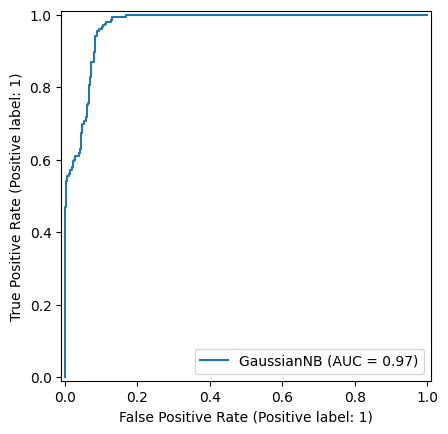

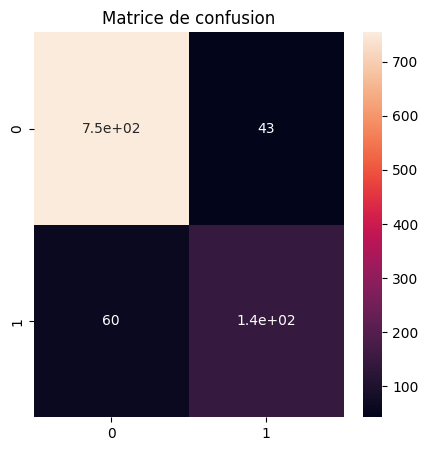

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       797
           1       0.77      0.71      0.74       205

    accuracy                           0.90      1002
   macro avg       0.85      0.83      0.84      1002
weighted avg       0.89      0.90      0.90      1002



/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(
/home/yann/.pyenv/versions/machineLearning/lib/python3.10/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GaussianNB was fitted with feature names
  warnings.warn(


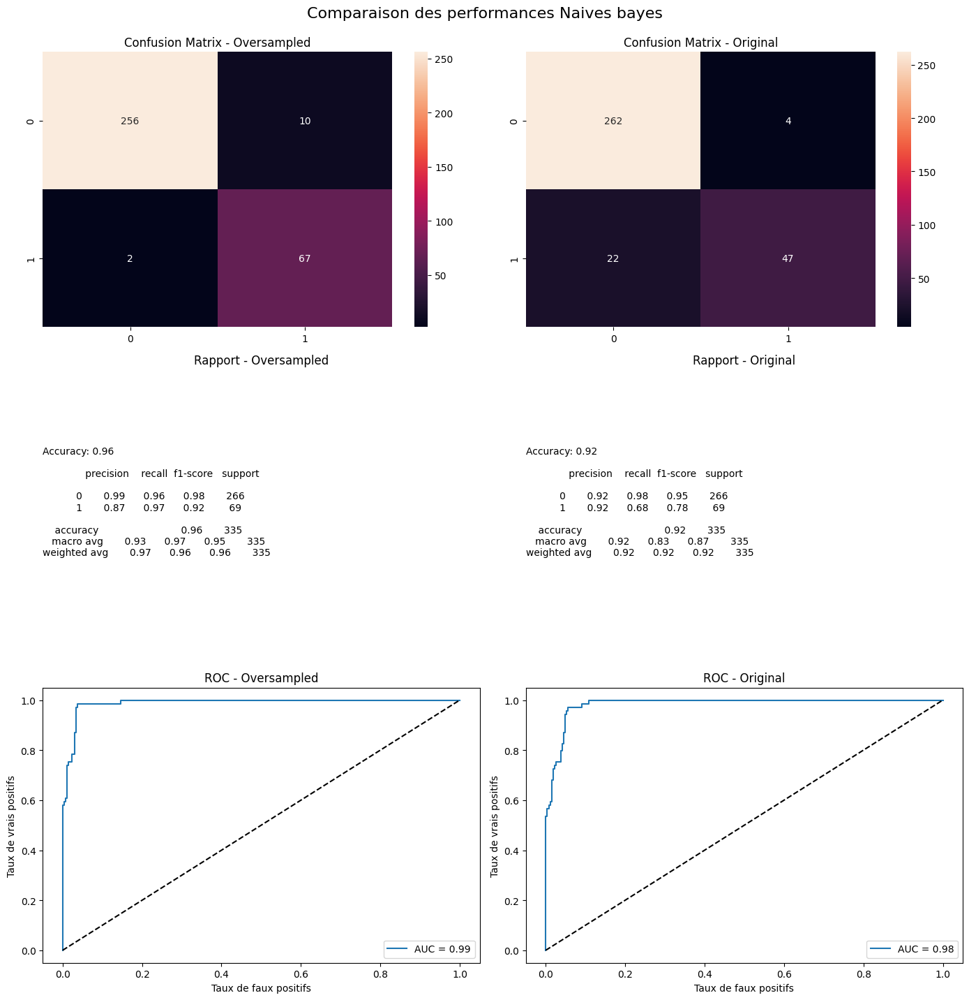

In [18]:
resampled_data_dict = {}

for oversampler in oversampler_dict.keys():
    print("Méthode d'over-sampling : ", oversampler)
    
    # Resampling des données
    X_resampled, y_resampled = oversampler_dict[oversampler].fit_resample(X_train, y_train)

    # Conversion en DataFrame si nécessaire
    if not isinstance(X_resampled, pd.DataFrame):
        X_resampled = pd.DataFrame(X_resampled, columns=X.columns)

    if isinstance(y_resampled, pd.DataFrame):
        y_resampled = y_resampled.iloc[:, 0]
    else:
        y_resampled = pd.Series(y_resampled, name='smoker')
    
    data_resampled = pd.concat([X_resampled, y_resampled], axis=1)

    # Sauvegarde pour éventuelle réutilisation
    resampled_data_dict[oversampler] = data_resampled
    
    # Visualisation comparative
    compare_smoker_distribution(data, data_resampled, title_suffix=f"({oversampler})")
    compare_pca_oversampling(data, {oversampler: data_resampled})

    # Comparaison de performance tout de suite après la visualisation
    print(f"\n####### COMPARAISON PERFORMANCE - MÉTHODE : {oversampler.upper()} #######")
    X_train_resampled = data_resampled.drop(columns='smoker')
    y_train_resampled = data_resampled['smoker']

    compare_Naives_bayes_performance(
        X_train_orig=X_train, y_train_orig=y_train,
        X_train_res=X_train_resampled, y_train_res=y_train_resampled,
        X_test=X_test, y_test=y_test
    )


## Xgboost
### requilibrage et control de l'impact sur le modeles 

Méthode d'over-sampling :  random


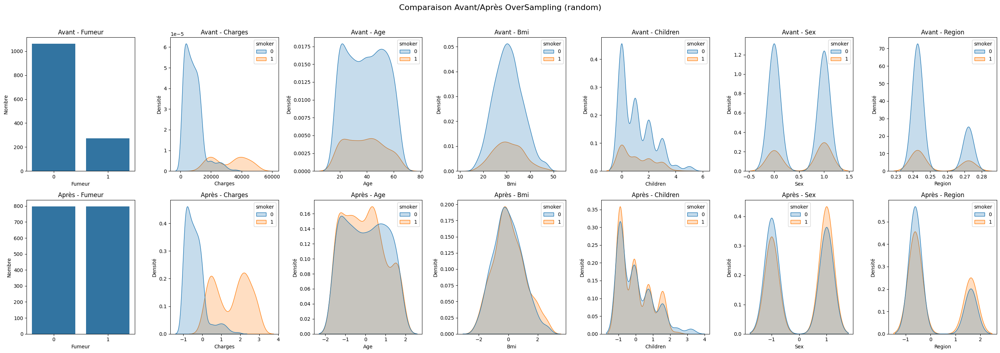

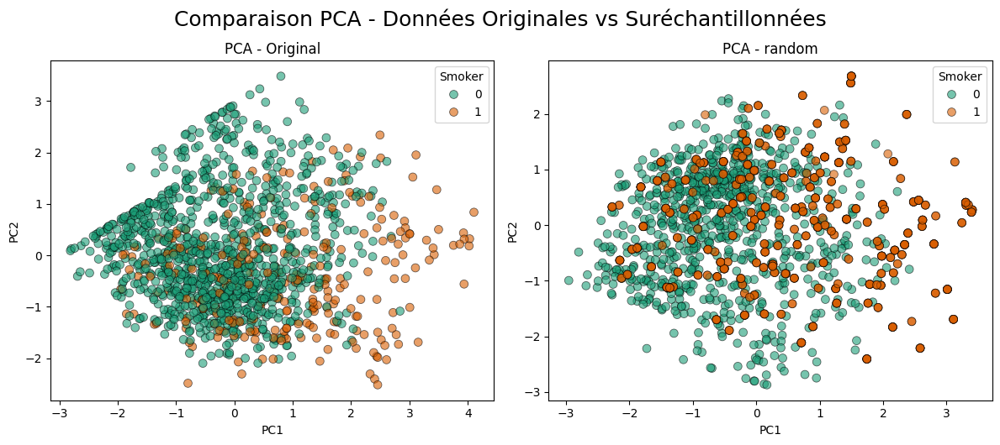


####### COMPARAISON PERFORMANCE - MÉTHODE : RANDOM #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9755332496863237


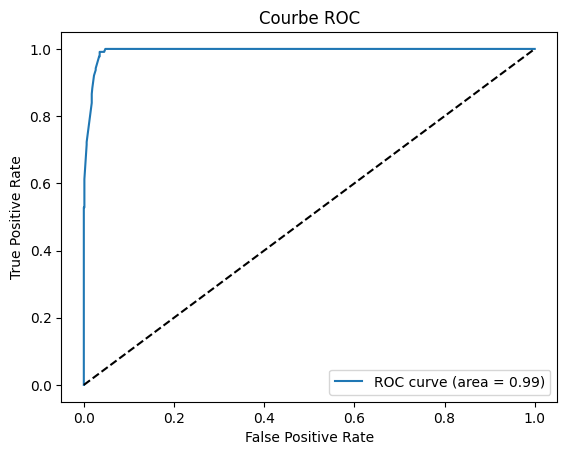

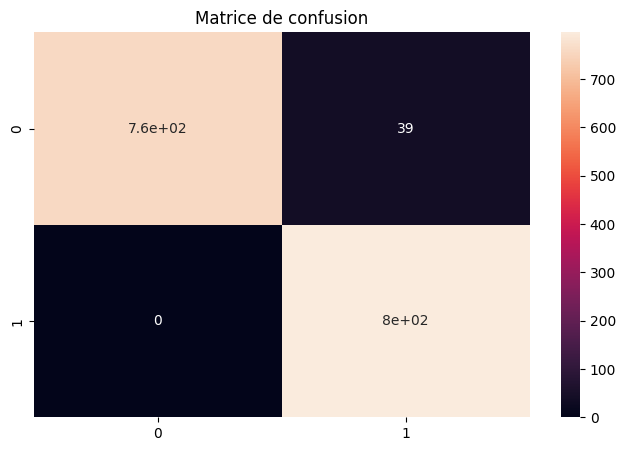

              precision    recall  f1-score   support

           0       1.00      0.95      0.97       797
           1       0.95      1.00      0.98       797

    accuracy                           0.98      1594
   macro avg       0.98      0.98      0.98      1594
weighted avg       0.98      0.98      0.98      1594


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


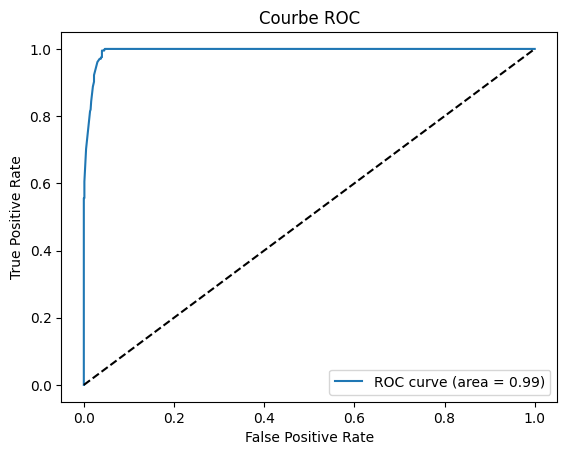

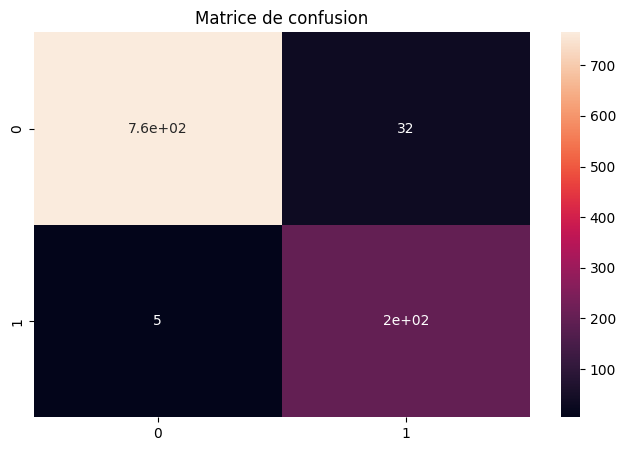

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



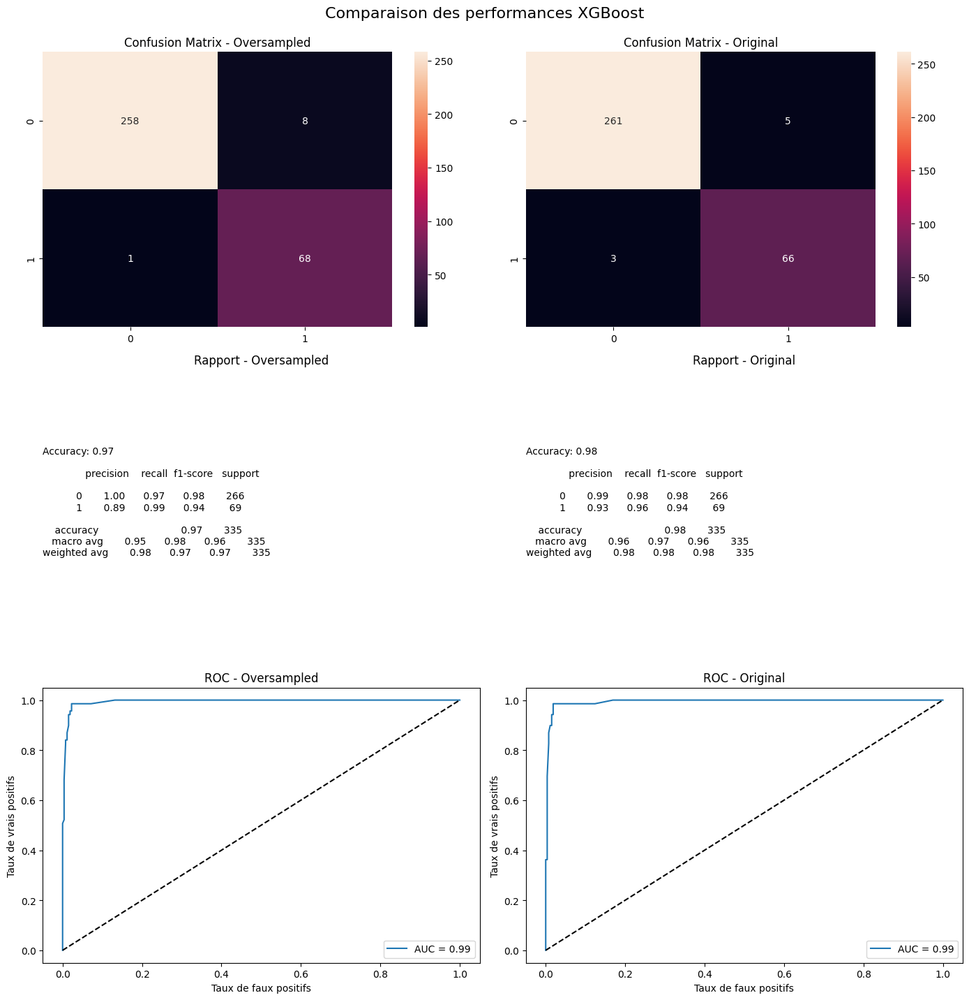

Méthode d'over-sampling :  smote


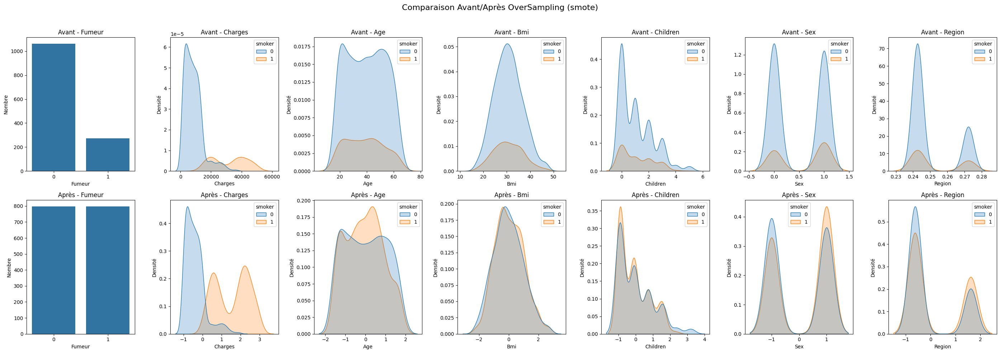

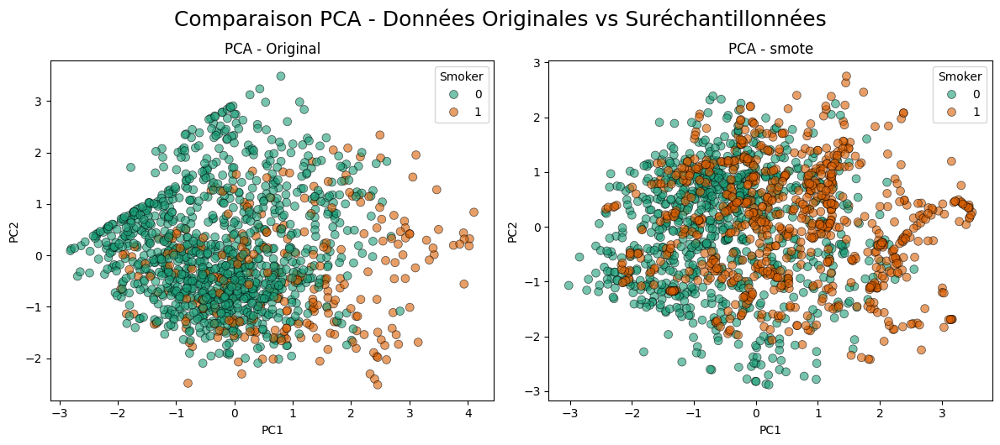


####### COMPARAISON PERFORMANCE - MÉTHODE : SMOTE #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.973651191969887


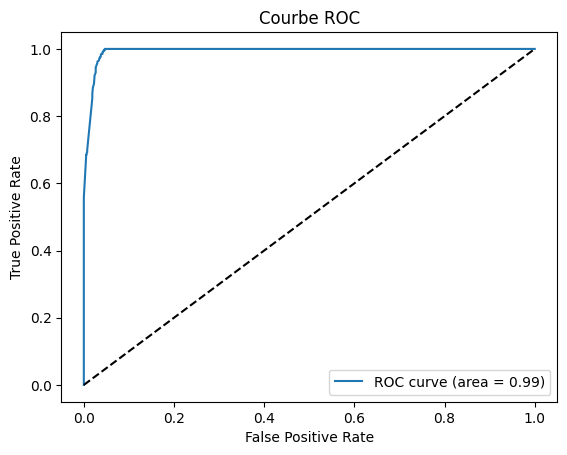

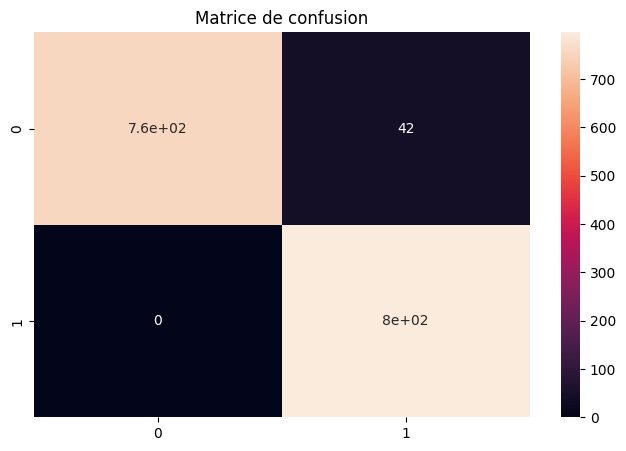

              precision    recall  f1-score   support

           0       1.00      0.95      0.97       797
           1       0.95      1.00      0.97       797

    accuracy                           0.97      1594
   macro avg       0.97      0.97      0.97      1594
weighted avg       0.97      0.97      0.97      1594


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


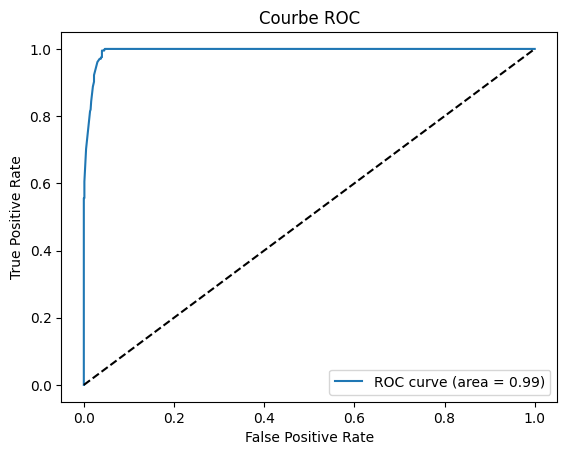

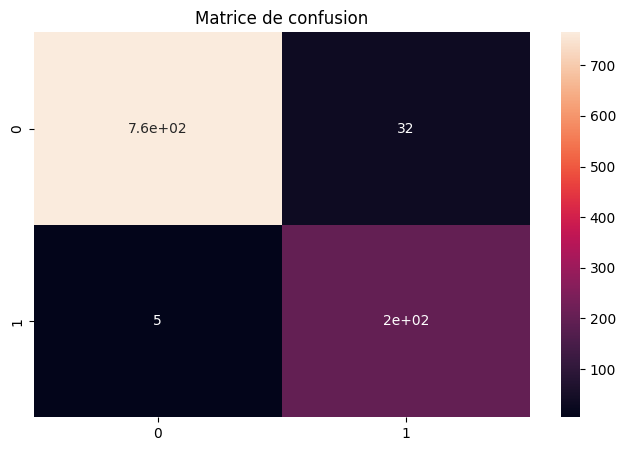

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



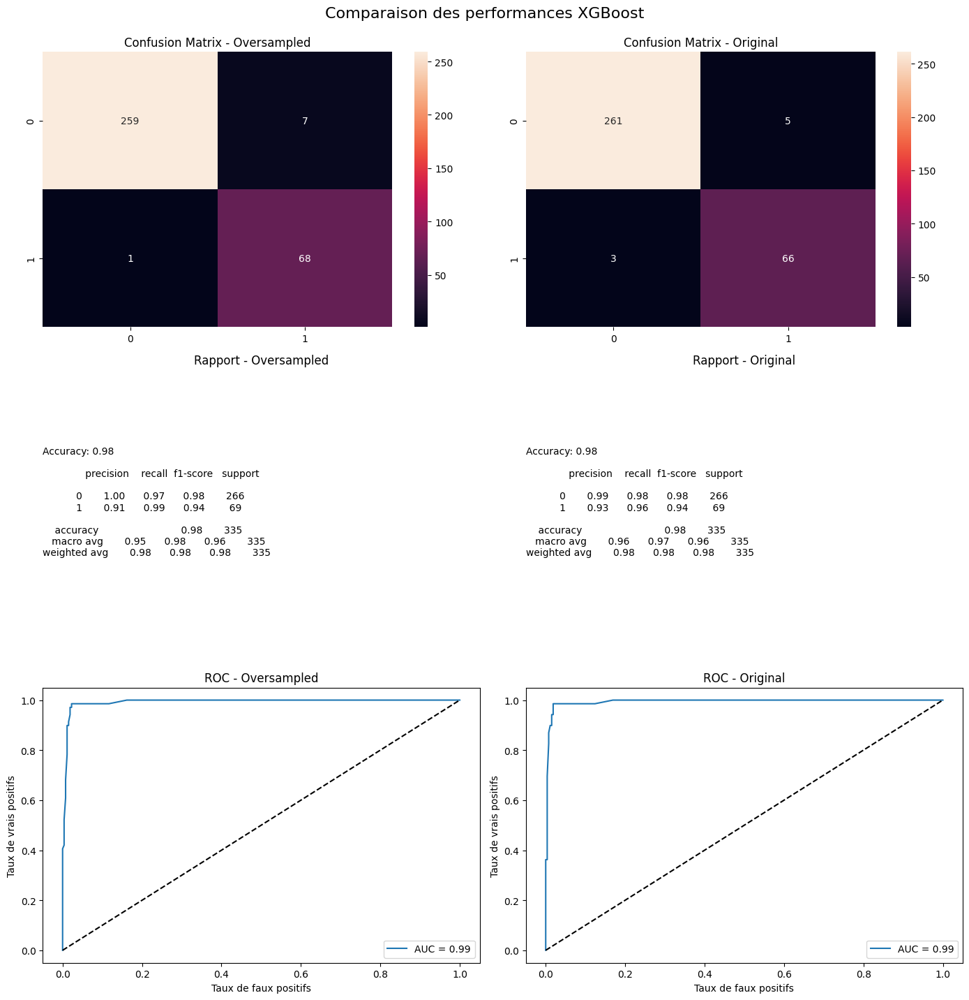

Méthode d'over-sampling :  adasyn


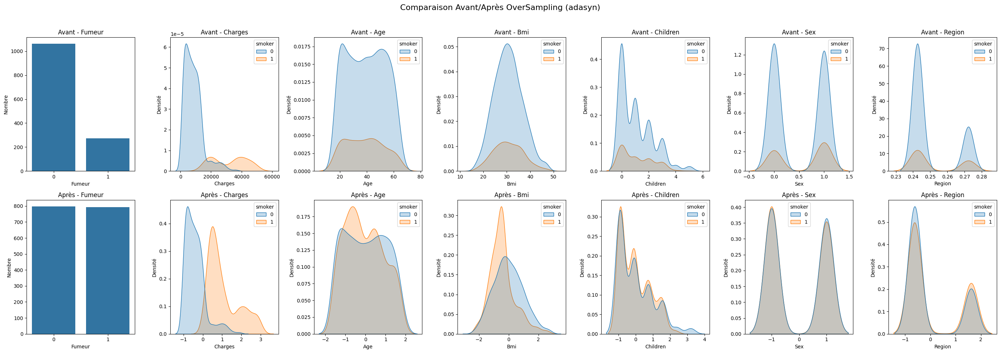

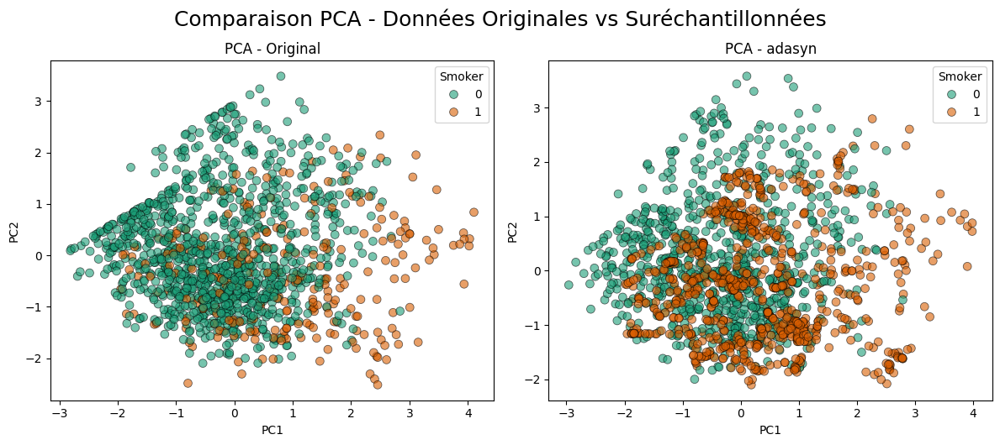


####### COMPARAISON PERFORMANCE - MÉTHODE : ADASYN #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9748427672955975


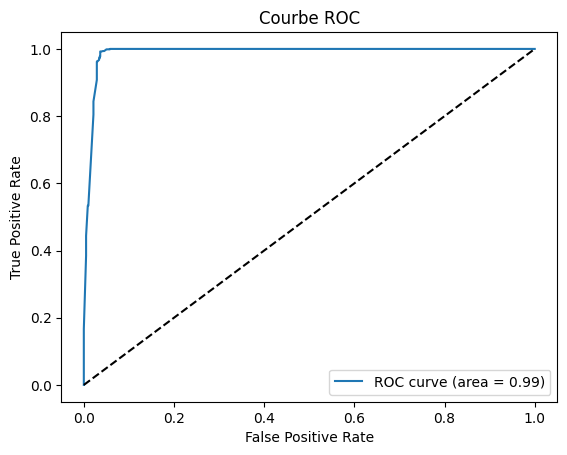

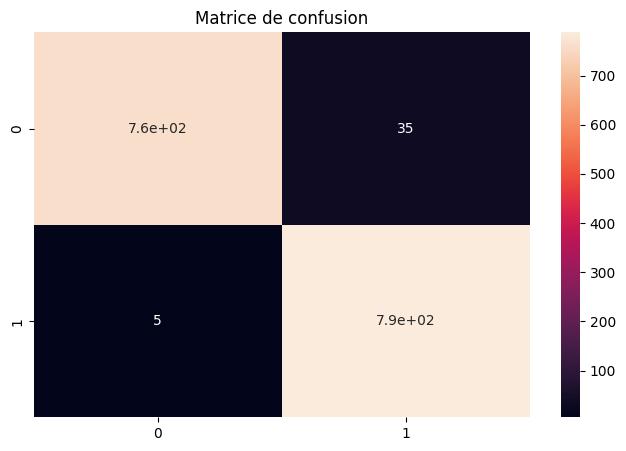

              precision    recall  f1-score   support

           0       0.99      0.96      0.97       797
           1       0.96      0.99      0.98       793

    accuracy                           0.97      1590
   macro avg       0.98      0.97      0.97      1590
weighted avg       0.98      0.97      0.97      1590


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


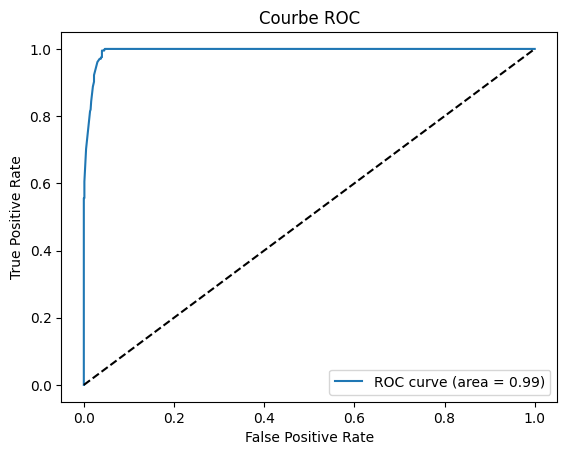

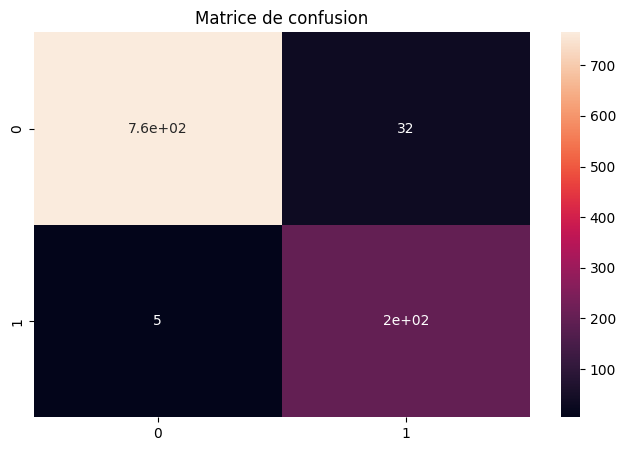

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



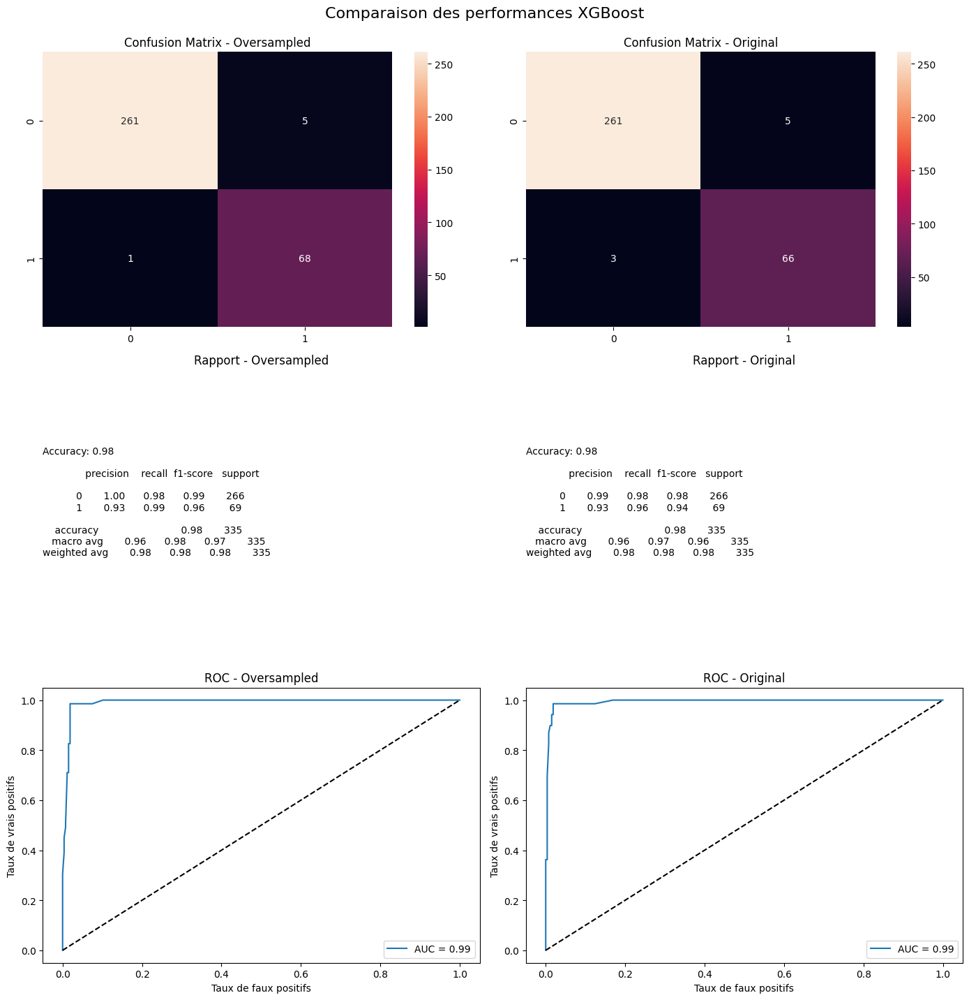

Méthode d'over-sampling :  border1


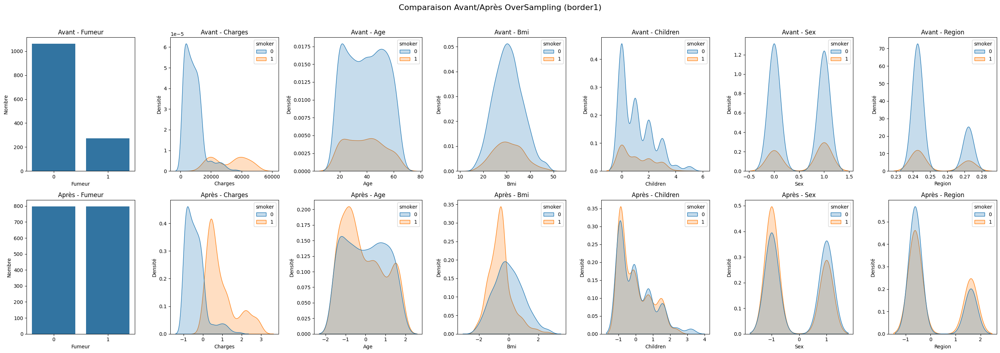

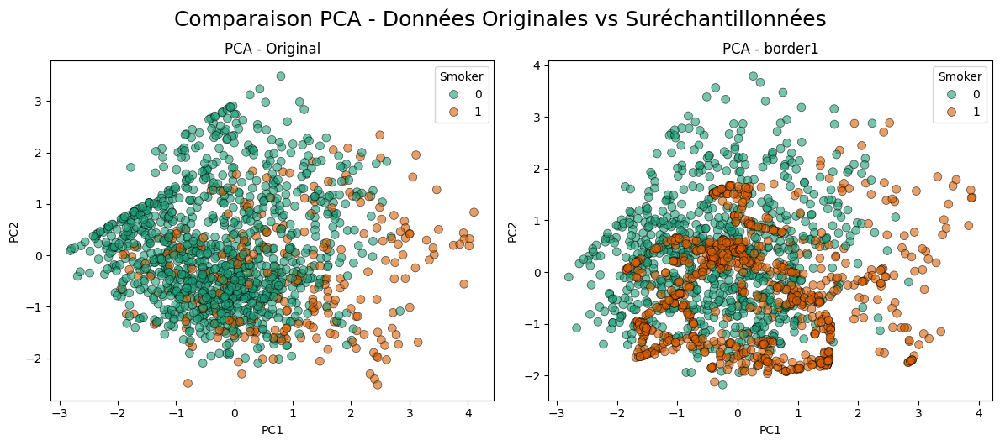


####### COMPARAISON PERFORMANCE - MÉTHODE : BORDER1 #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9767879548306148


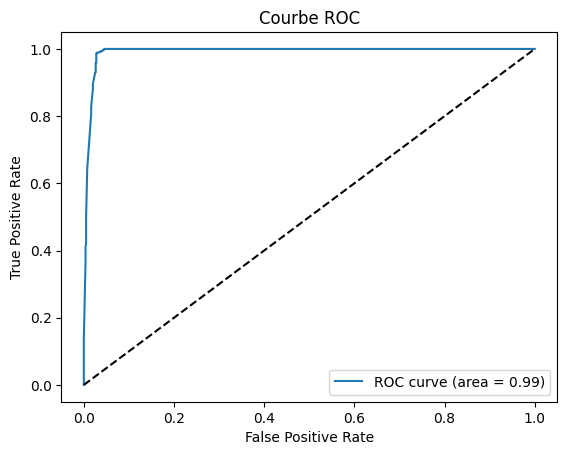

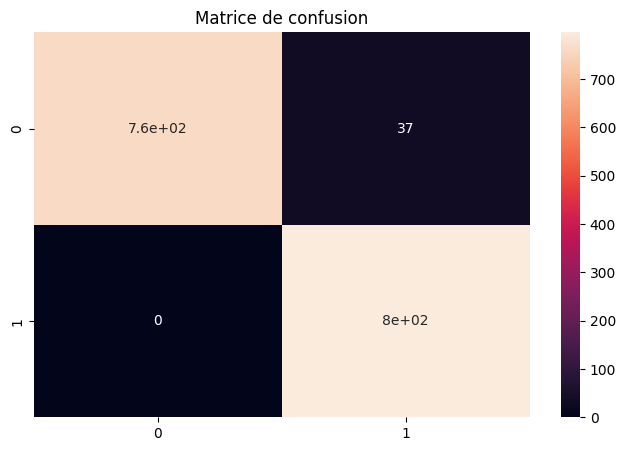

              precision    recall  f1-score   support

           0       1.00      0.95      0.98       797
           1       0.96      1.00      0.98       797

    accuracy                           0.98      1594
   macro avg       0.98      0.98      0.98      1594
weighted avg       0.98      0.98      0.98      1594


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


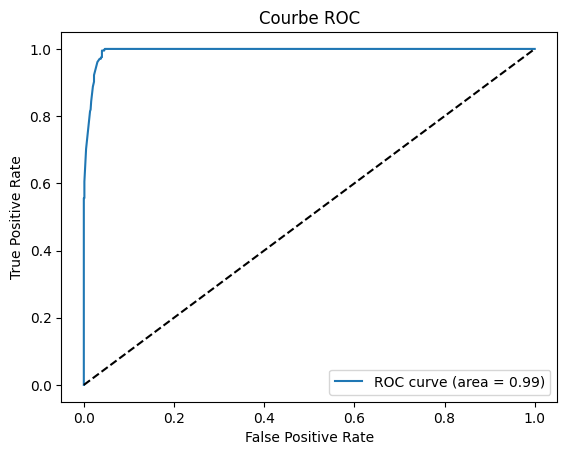

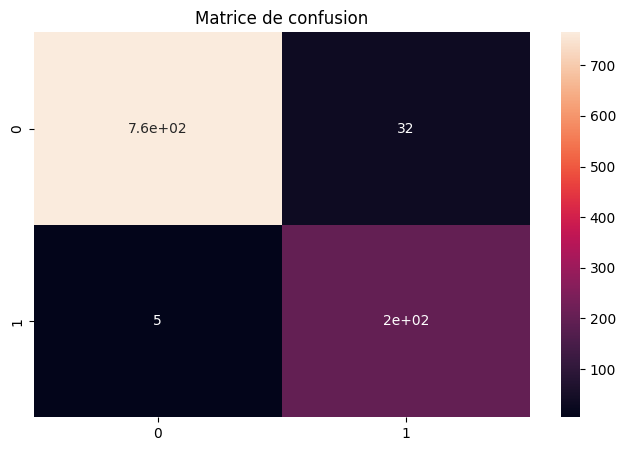

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



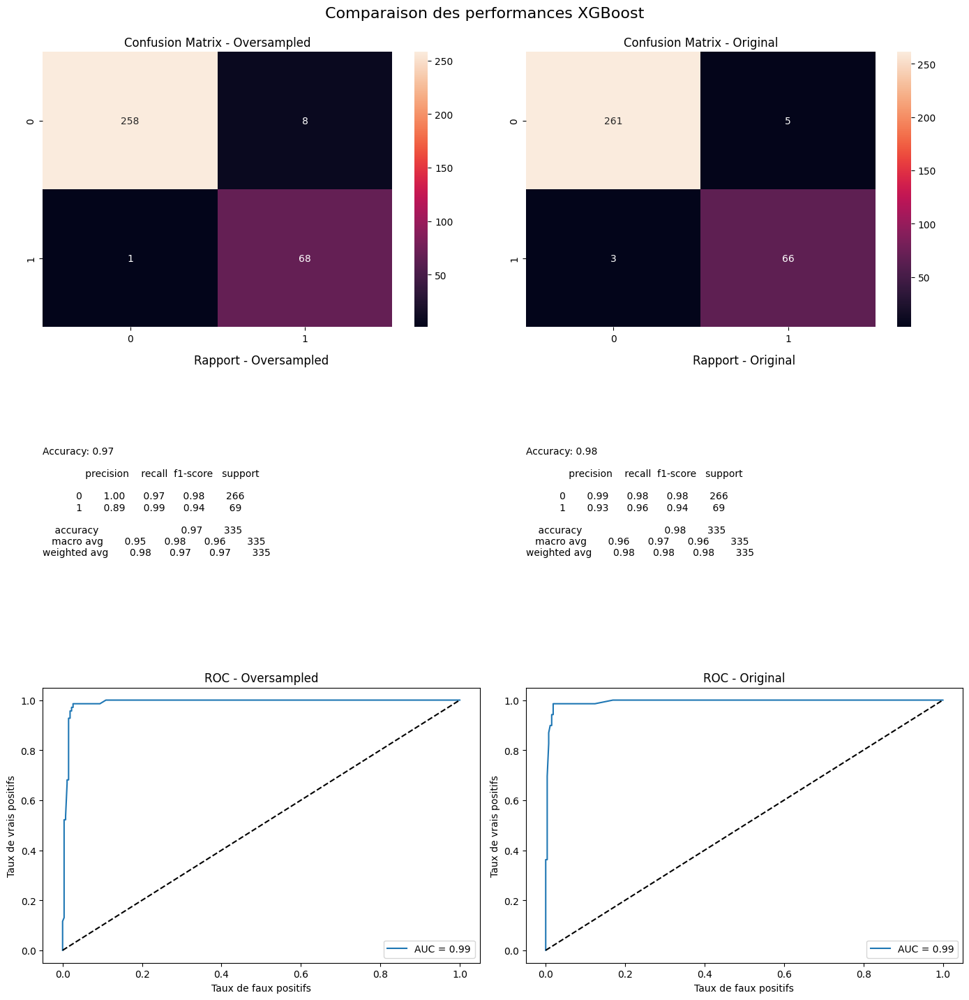

Méthode d'over-sampling :  border2


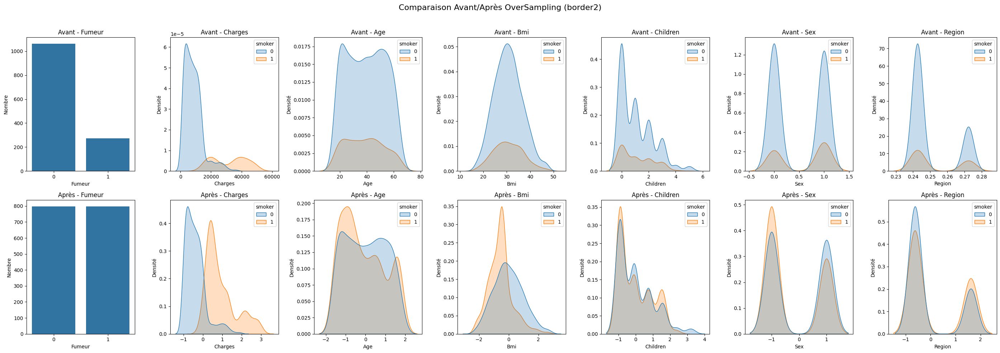

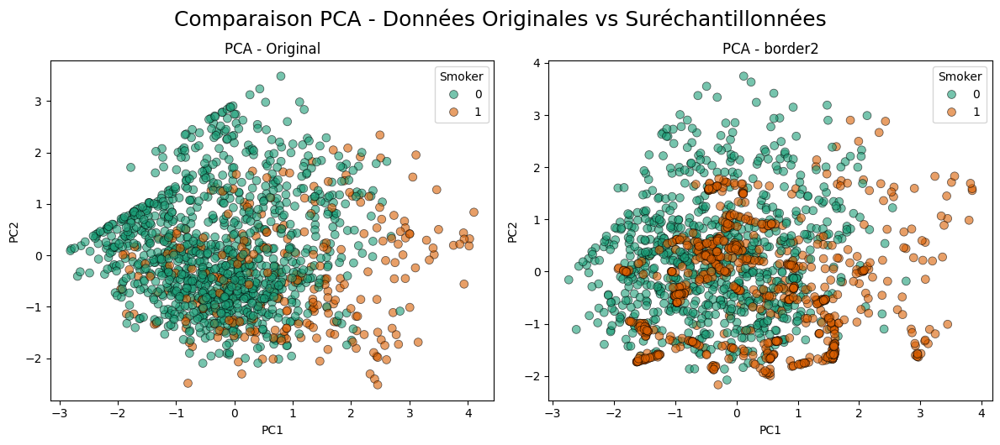


####### COMPARAISON PERFORMANCE - MÉTHODE : BORDER2 #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.9698870765370138


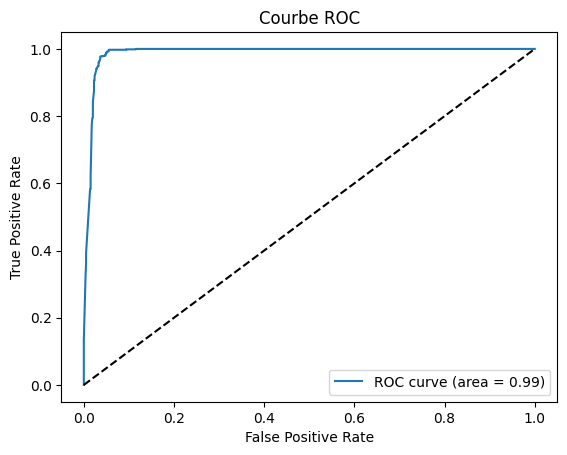

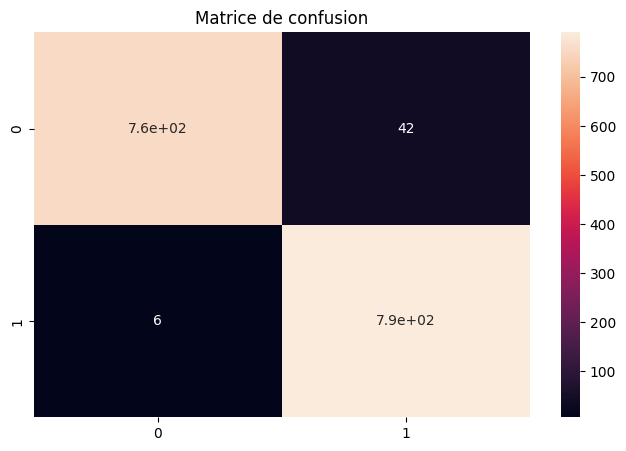

              precision    recall  f1-score   support

           0       0.99      0.95      0.97       797
           1       0.95      0.99      0.97       797

    accuracy                           0.97      1594
   macro avg       0.97      0.97      0.97      1594
weighted avg       0.97      0.97      0.97      1594


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


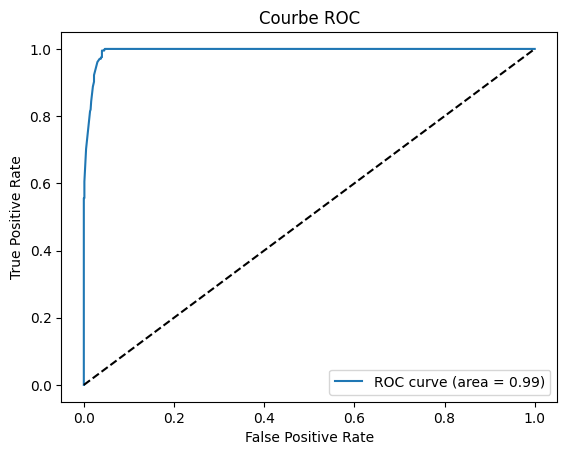

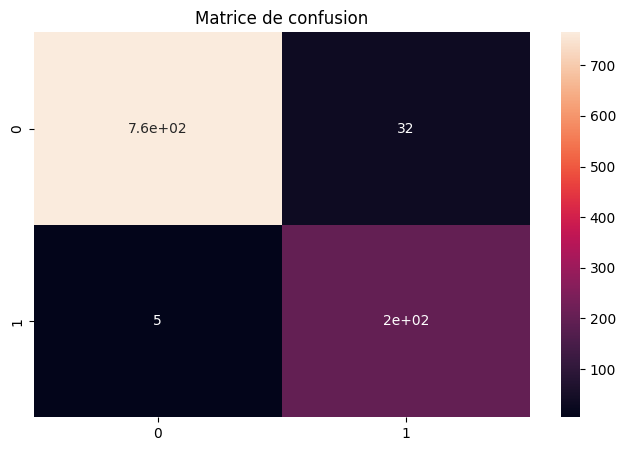

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



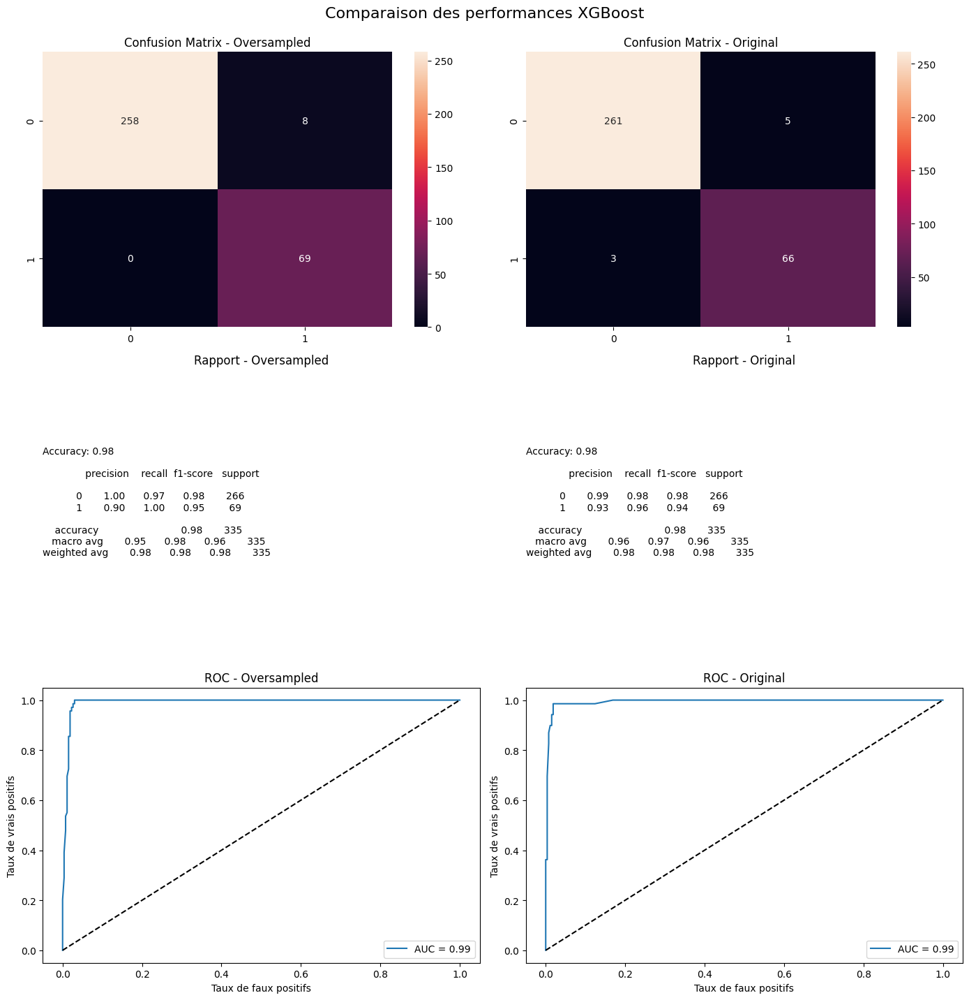

Méthode d'over-sampling :  svm


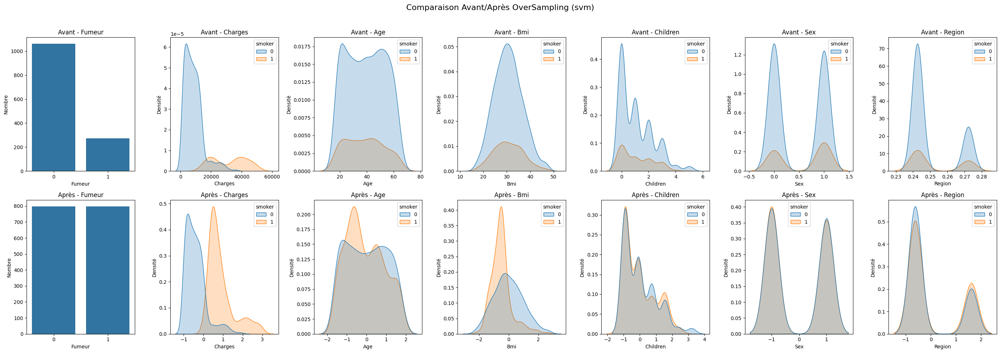

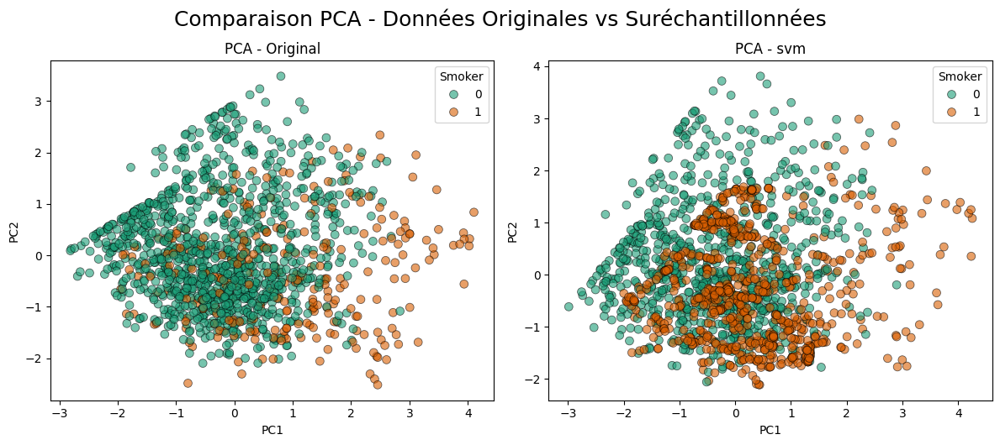


####### COMPARAISON PERFORMANCE - MÉTHODE : SVM #######
=== Entraînement sur données suréchantillonnées ===
Accuracy :  0.972396486825596


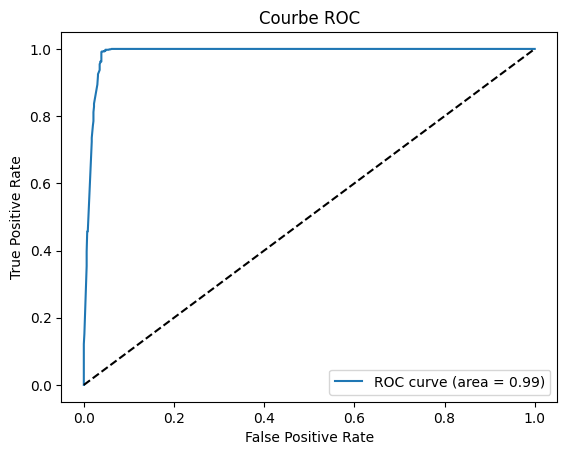

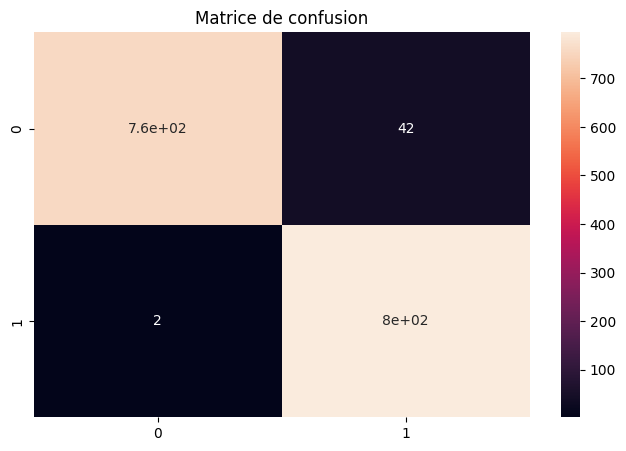

              precision    recall  f1-score   support

           0       1.00      0.95      0.97       797
           1       0.95      1.00      0.97       797

    accuracy                           0.97      1594
   macro avg       0.97      0.97      0.97      1594
weighted avg       0.97      0.97      0.97      1594


=== Entraînement sur données originales ===
Accuracy :  0.9630738522954092


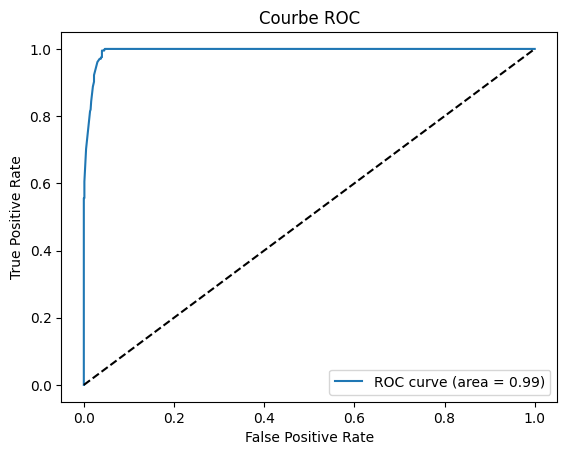

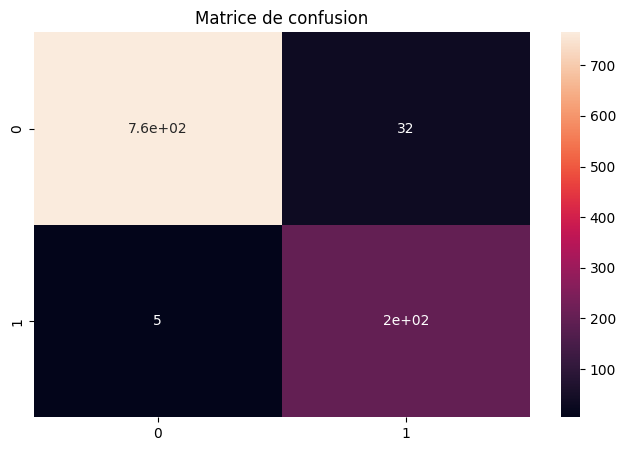

              precision    recall  f1-score   support

           0       0.99      0.96      0.98       797
           1       0.86      0.98      0.92       205

    accuracy                           0.96      1002
   macro avg       0.93      0.97      0.95      1002
weighted avg       0.97      0.96      0.96      1002



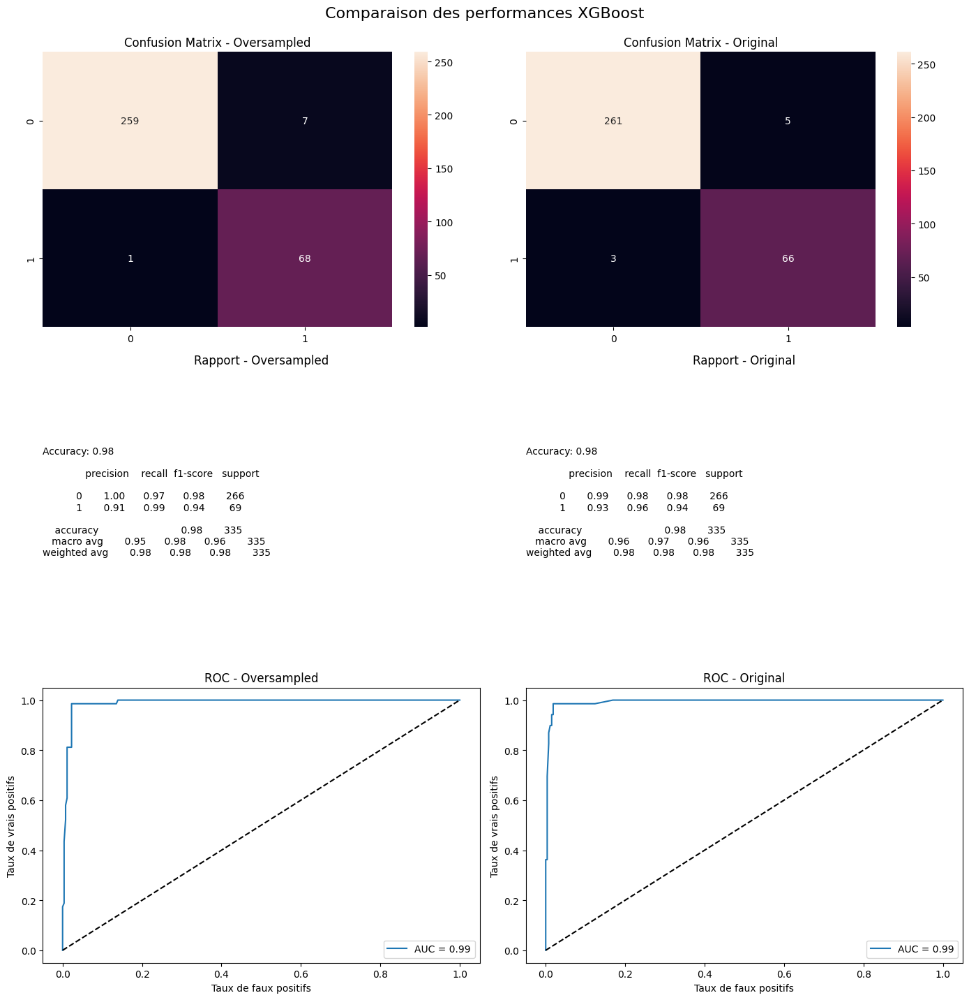

In [19]:
resampled_data_dict = {}

for oversampler in oversampler_dict.keys():
    print("Méthode d'over-sampling : ", oversampler)
    
    # Resampling des données
    X_resampled, y_resampled = oversampler_dict[oversampler].fit_resample(X_train, y_train)

    # Conversion en DataFrame si nécessaire
    if not isinstance(X_resampled, pd.DataFrame):
        X_resampled = pd.DataFrame(X_resampled, columns=X.columns)

    if isinstance(y_resampled, pd.DataFrame):
        y_resampled = y_resampled.iloc[:, 0]
    else:
        y_resampled = pd.Series(y_resampled, name='smoker')
    
    data_resampled = pd.concat([X_resampled, y_resampled], axis=1)

    # Sauvegarde pour éventuelle réutilisation
    resampled_data_dict[oversampler] = data_resampled
    
    # Visualisation comparative
    compare_smoker_distribution(data, data_resampled, title_suffix=f"({oversampler})")
    compare_pca_oversampling(data, {oversampler: data_resampled})

    # Comparaison de performance tout de suite après la visualisation
    print(f"\n####### COMPARAISON PERFORMANCE - MÉTHODE : {oversampler.upper()} #######")
    X_train_resampled = data_resampled.drop(columns='smoker')
    y_train_resampled = data_resampled['smoker']

    compare_xgboost_performance(
        X_train_orig=X_train, y_train_orig=y_train,
        X_train_res=X_train_resampled, y_train_res=y_train_resampled,
        X_test=X_test, y_test=y_test
    )
